<a href="https://colab.research.google.com/github/gerdac/instance_segmentation_thermal/blob/main/1_Detectron2_coco_instance_thermal_model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Module imports

## Install darwin

In [ ]:
pip install darwin-py

In [ ]:
from darwin.client import Client
from darwin.dataset import RemoteDataset
from time import sleep
from darwin.dataset.release import Release
from darwin.exceptions import NotFound
from pathlib import Path
from darwin.torch.utils import detectron2_register_dataset
from darwin.dataset.split_manager import split_dataset

## Install detectron2


<img src="https://dl.fbaipublicfiles.com/detectron2/Detectron2-Logo-Horz.png" width="500">


Detectron2 Tutorial https://colab.research.google.com/drive/16jcaJoc6bCFAQ96jDe2HwtXj7BMD_-m5#scrollTo=dq9GY37ml1kr from the read the docs https://detectron2.readthedocs.io/en/latest/tutorials/getting_started.html

In [ ]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities (e.g. compiled operators).
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 2.5 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
Cloning into 'detectron2'...
remote: Enumerating objects: 15508, done.
remote: Counting objects: 100% (233/233), done.
remote: Compressing objects: 100% (194/194), done.
remote: Total 15508 (delta 66), reused 177 (delta 39), pack-reused 15275
Receiving objects: 100% (15508/15508), 6.39 MiB | 9.79 MiB/s, done.
Resolving deltas: 100% (11181/11181), done.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.9 MB/s eta 0:00:0

In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2023 NVIDIA Corporation
Built on Tue_Aug_15_22:02:13_PDT_2023
Cuda compilation tools, release 12.2, V12.2.140
Build cuda_12.2.r12.2/compiler.33191640_0
torch:  2.2 ; cuda:  cu121
detectron2: 0.6


In [ ]:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor, DefaultTrainer
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog, build_detection_test_loader, build_detection_train_loader, DatasetMapper
from detectron2.data import detection_utils as utils
from detectron2.data.datasets import register_coco_instances
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.checkpoint import DetectionCheckpointer, Checkpointer

import detectron2.data.transforms as T



## Some basic setup

In [ ]:
# import some common libraries
import numpy as np
import os, json, cv2, random, copy
from google.colab.patches import cv2_imshow

# import utilities for visualization
from PIL import Image
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
sns.set(color_codes=True)

In [ ]:
!pip install sensitivity
from sensitivity import SensitivityAnalyzer
# https://nickderobertis.github.io/sensitivity/tutorial.html#install
# https://nickderobertis.github.io/sensitivity/auto_examples/sensitivity_analysis.html

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 10.0 MB/s eta 0:00:00


In [ ]:
# Mount google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Pulling from darwin

In [ ]:
API_KEY = "GcUy_xK.qVFwUD75rRvTFPIMn2_u9nH8d5Lb3vAl"
client = Client.from_api_key(API_KEY)

In [ ]:
dataset: RemoteDataset = client.get_remote_dataset("thermal23")

In [ ]:
!darwin authenticate

API key: 
Make cms the default team? [y/N] y
Datasets directory [~/.darwin/datasets]: thermal23
Authentication succeeded.


In [ ]:
!darwin dataset remote

┏━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┓
┃ Name           ┃ Item Count ┃ Complete Items ┃
┡━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━┩
│ cms/thermal    │         40 │           0.0% │
│ cms/thermal23  │        577 │           6.9% │
│ cms/validation │          8 │          62.5% │
└────────────────┴────────────┴────────────────┘


In [ ]:
!darwin dataset releases cms/thermal23

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Name                                 ┃ Item Count ┃ Class Count ┃               Export Date ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│ cms/thermal23:20240314-nofloornodoor │         40 │           6 │ 2024-03-14 15:29:44+00:00 │
│ cms/thermal23:20240314-nodoor        │         40 │           7 │ 2024-03-14 15:29:14+00:00 │
│ cms/thermal23:20240314               │         40 │          10 │ 2024-03-14 15:28:41+00:00 │
│ cms/thermal23:20240314-coco-train    │         30 │          10 │ 2024-03-14 13:33:01+00:00 │
│ cms/thermal23:20240314-coco-test     │          4 │          10 │ 2024-03-14 13:32:40+00:00 │
│ cms/thermal23:20240314-coco-val      │          6 │          10 │ 2024-03-14 13:32:17+00:00 │
│ cms/thermal23:20240314-coco-all      │         40 │          10 │ 2024-03-14 13:21:33+00:00 │
│ cms/thermal23:20240312-test          │

In [ ]:
!darwin dataset pull cms/thermal23:20240314

Going to download 40 files to thermal23/cms/thermal23/images .
━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━
Total file count after download completed 83.
Dataset cms/thermal23:20240314 downloaded at thermal23/cms/thermal23 .


In [ ]:
!darwin dataset pull cms/thermal23:20240314 --folders

Going to download 40 files to thermal23/cms/thermal23/images .
━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━
Total file count after download completed 40.
Dataset cms/thermal23:20240314 downloaded at thermal23/cms/thermal23 .


In [ ]:
!darwin dataset releases cms/validation

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Name                                    ┃ Item Count ┃ Class Count ┃               Export Date ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│ cms/validation:validation-nofloornodoor │          5 │           6 │ 2024-03-14 15:31:31+00:00 │
│ cms/validation:validation-nodoor        │          5 │           7 │ 2024-03-14 15:31:11+00:00 │
│ cms/validation:validation               │          5 │          10 │ 2024-03-14 15:30:53+00:00 │
│ cms/validation:validation-coco-z3       │          2 │          10 │ 2024-03-14 14:55:36+00:00 │
│ cms/validation:validation-coco-z1       │          3 │           7 │ 2024-03-14 14:55:02+00:00 │
│ cms/validation:validation-coco-all      │          5 │          10 │ 2024-03-14 14:47:58+00:00 │
└─────────────────────────────────────────┴────────────┴─────────────┴───────────────────────────┘


In [ ]:
!darwin dataset pull cms/validation:validation

Going to download 5 files to thermal23/cms/validation/images .
━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━
Total file count after download completed 5.
Dataset cms/validation:validation downloaded at thermal23/cms/validation .


In [ ]:
!darwin dataset pull cms/validation:validation --folders

Going to download 5 files to thermal23/cms/validation/images .
━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━
Total file count after download completed 10.
Dataset cms/validation:validation downloaded at thermal23/cms/validation .


In [ ]:
!darwin dataset local

┏━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━━━┳━━━━━━━━━┓
┃ Name           ┃ Image Count ┃ Sync Date ┃    Size ┃
┡━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━━━╇━━━━━━━━━┩
│ cms/validation │          10 │     today │  3.7 MB │
│ cms/thermal23  │          80 │     today │ 28.3 MB │
└────────────────┴─────────────┴───────────┴─────────┘


## Copy to drive

In [ ]:
!zip -r /content/darwin_files.zip /content/thermal23/cms

  adding: content/thermal23/cms/ (stored 0%)
  adding: content/thermal23/cms/validation/ (stored 0%)
  adding: content/thermal23/cms/validation/releases/ (stored 0%)
  adding: content/thermal23/cms/validation/releases/validation/ (stored 0%)
  adding: content/thermal23/cms/validation/releases/validation/lists/ (stored 0%)
  adding: content/thermal23/cms/validation/releases/validation/lists/classes_polygon.txt (deflated 26%)
  adding: content/thermal23/cms/validation/releases/validation/annotations/ (stored 0%)
  adding: content/thermal23/cms/validation/releases/validation/annotations/img_20240224_043150_838.json (deflated 80%)
  adding: content/thermal23/cms/validation/releases/validation/annotations/img_20240224_044444_401.json (deflated 72%)
  adding: content/thermal23/cms/validation/releases/validation/annotations/img_20240224_045246_861.json (deflated 75%)
  adding: content/thermal23/cms/validation/releases/validation/annotations/img_20240224_051433_797.json (deflated 72%)
  adding

In [ ]:
!cp /content/darwin_files.zip /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23

# Thermal

## Prepare dataset

### Dataset splits

In [ ]:
# Establish training, validation and test sets directly from google drive
register_coco_instances("coco_dataset_train", {}, "/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Train/output.json", "/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Train")
register_coco_instances("coco_dataset_val", {}, "/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/output.json", "/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate")
register_coco_instances("coco_dataset_test", {}, "/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test/output.json", "/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test")

In [ ]:
# Establish training, validation and test sets from local memory after download from darwin
# register_coco_instances("coco_dataset_train", {}, "/content/thermal23/cms/thermal23/images/Train/output.json", "/content/thermal23/cms/thermal23/images/Train")
# register_coco_instances("coco_dataset_val", {}, "/content/thermal23/cms/thermal23/images/Validate/output.json", "/content/thermal23/cms/thermal23/images/Validate")
# register_coco_instances("coco_dataset_test", {}, "/content/thermal23/cms/thermal23/images/Test/output.json", "/content/thermal23/cms/thermal23/images/Test")

[03/20 13:57:57 d2.data.datasets.coco]: Loading /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Train/output.json takes 4.60 seconds.
[03/20 13:57:57 d2.data.datasets.coco]: Loaded 30 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Train/output.json


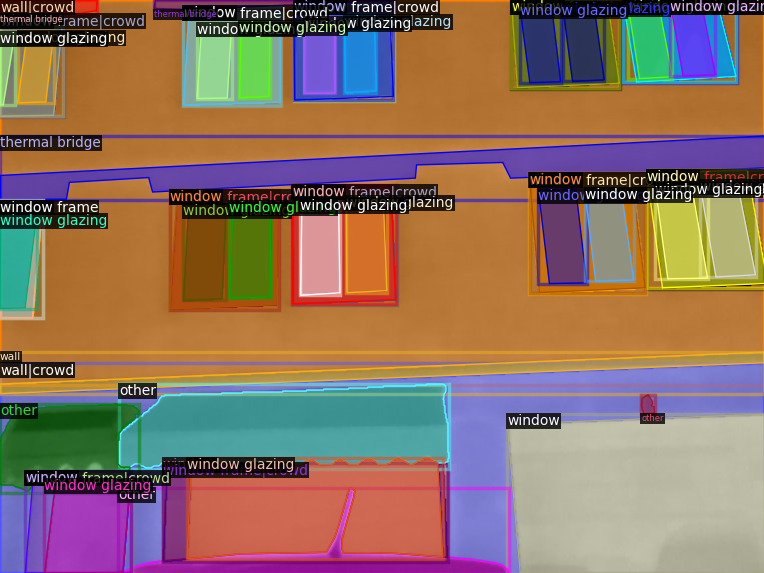

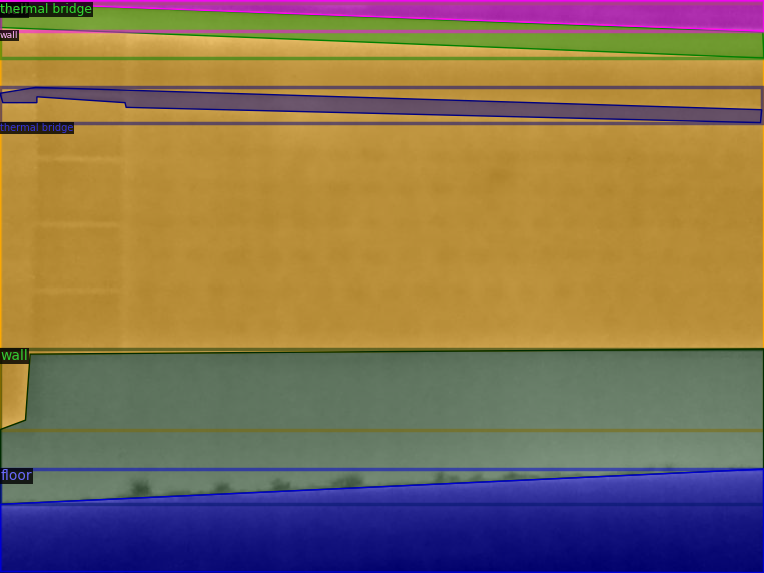

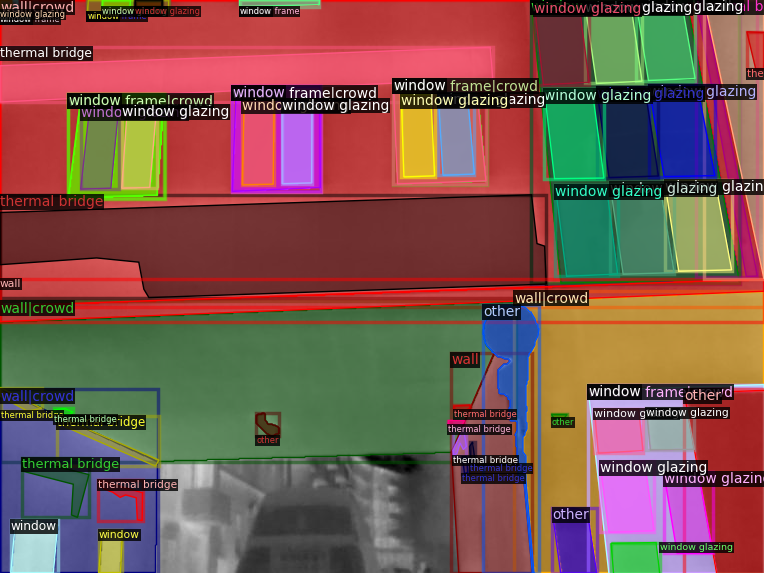

In [ ]:
# Visualize training data
my_dataset_train_metadata = MetadataCatalog.get("coco_dataset_train")
dataset_dicts = DatasetCatalog.get("coco_dataset_train")

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

### Full dataset

In [ ]:
register_coco_instances("coco_dataset_all", {}, "/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/output.json", "/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images")

[03/20 13:58:03 d2.data.datasets.coco]: Loaded 40 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/output.json


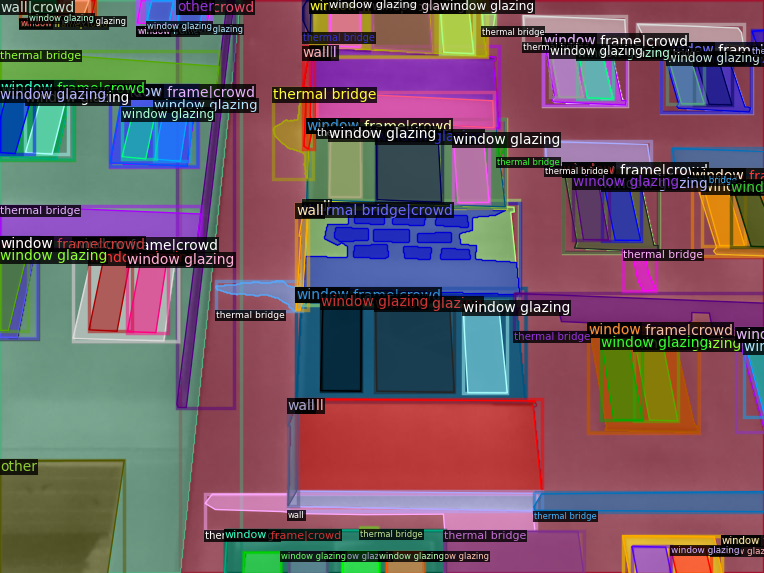

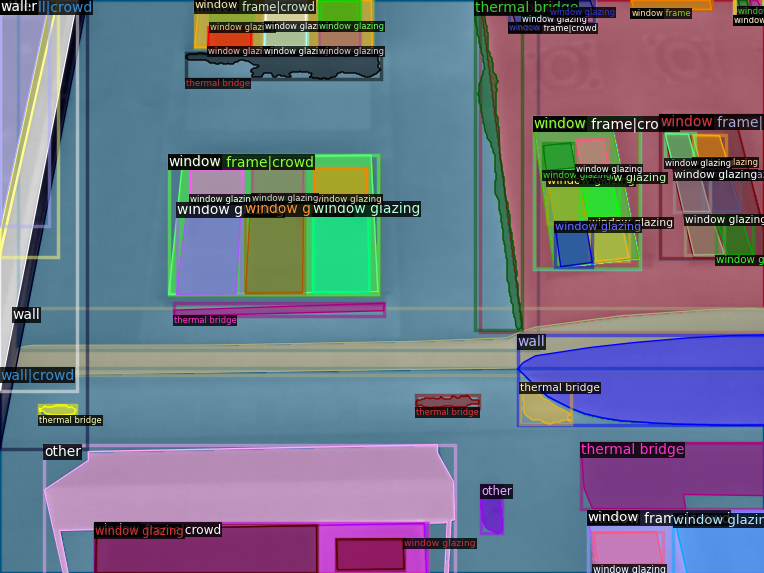

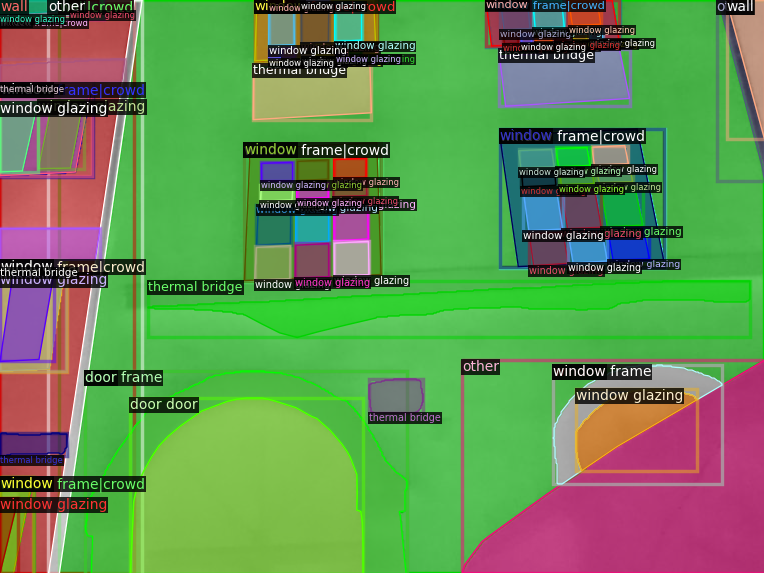

In [ ]:
# Visualize training data
my_dataset_train_metadata = MetadataCatalog.get("coco_dataset_all")
dataset_dicts = DatasetCatalog.get("coco_dataset_all")

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

## Train dataset

###  Fine-tuning a pretrained model

In [ ]:
#  Fine-tuning a COCO-pretrained R50-FPN Mask R-CNN model on the dataset
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ('coco_dataset_train',)
cfg.DATASETS.TEST = ('coco_dataset_val',)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2  # This is the real "batch size"
cfg.SOLVER.BASE_LR = 0.0005
cfg.SOLVER.MAX_ITER = 1000
cfg.SOLVER.STEPS = (3000, 4500)
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # The "RoIHead batch size". 128 is faster, and good enough for this dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = len(MetadataCatalog.get('coco_dataset_train').thing_classes)

### Train

In [ ]:
# Train
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

### Evaluate model

In [ ]:
# Evaluate the model on validation dataset
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
evaluator = COCOEvaluator('coco_dataset_val', cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, 'coco_dataset_val')
inference_on_dataset(trainer.model, val_loader, evaluator)

[03/15 10:09:20 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [03/15 10:09:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[03/15 10:09:20 d2.data.datasets.coco]: Loaded 6 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/output.json
[03/15 10:09:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[03/15 10:09:20 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[03/15 10:09:20 d2.data.common]: Serializing 6 elements to byte tensors and concatenating them all ...
[03/15 10:09:20 d2.data.common]: Serialized dataset takes 0.12 MiB
[03/15 10:09:20 d2.evaluation

OrderedDict([('bbox',
              {'AP': 23.461328458449252,
               'AP50': 32.32281858069759,
               'AP75': 25.666407394585505,
               'APs': 24.304432922550763,
               'APm': 16.779554967109675,
               'APl': 31.419979987553692,
               'AP-wall': 6.6527152715271525,
               'AP-window glazing': 42.1610498165579,
               'AP-door': 0.0,
               'AP-window': 54.73763549739948,
               'AP-window frame': 0.0,
               'AP-thermal bridge': 8.930039862213384,
               'AP-door frame': 0.0,
               'AP-floor': 90.0,
               'AP-door door': 0.0,
               'AP-other': 32.13184413679463}),
             ('segm',
              {'AP': 23.38321264230045,
               'AP50': 32.078745468299,
               'AP75': 25.755419682844117,
               'APs': 24.560581478129492,
               'APm': 13.843723736497681,
               'APl': 34.335087908107546,
               'AP-wall': 6.3

In [ ]:
# Evaluate the model on test dataset
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
evaluator = COCOEvaluator('coco_dataset_test', cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, 'coco_dataset_test')
inference_on_dataset(trainer.model, val_loader, evaluator)

[03/15 10:09:40 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [03/15 10:09:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[03/15 10:09:41 d2.data.datasets.coco]: Loaded 4 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test/output.json
[03/15 10:09:41 d2.data.build]: Distribution of instances among all 10 categories:
|  category  | #instances   |   category    | #instances   |   category    | #instances   |
|:----------:|:-------------|:-------------:|:-------------|:-------------:|:-------------|
|    wall    | 9            | window glaz.. | 55           |     door      | 1            |
|   window   | 16           | window frame  | 2            | thermal bri.. | 15           |
| door frame | 1            |     floor     | 1  

OrderedDict([('bbox',
              {'AP': 38.03100045416713,
               'AP50': 52.10327035570202,
               'AP75': 37.700370120255855,
               'APs': 42.693697941222695,
               'APm': 53.190340458895726,
               'APl': 39.38073247190409,
               'AP-wall': 39.06889590057907,
               'AP-window glazing': 53.76087407917451,
               'AP-door': 49.99999999999999,
               'AP-window': 74.16834265844167,
               'AP-window frame': 0.0,
               'AP-thermal bridge': 10.51132613261326,
               'AP-door frame': 0.0,
               'AP-floor': 99.99999999999997,
               'AP-door door': 0.0,
               'AP-other': 52.8005657708628}),
             ('segm',
              {'AP': 37.58815607458762,
               'AP50': 51.24788193224429,
               'AP75': 41.925697227947055,
               'APs': 45.42001926436987,
               'APm': 34.46344044448416,
               'APl': 42.039801599207536,
     

In [ ]:
# Evaluate the model on training dataset
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
evaluator = COCOEvaluator('coco_dataset_train', cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, 'coco_dataset_train')
inference_on_dataset(trainer.model, val_loader, evaluator)

[03/15 10:10:01 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [03/15 10:10:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[03/15 10:10:01 d2.data.datasets.coco]: Loaded 30 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Train/output.json
[03/15 10:10:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[03/15 10:10:01 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[03/15 10:10:01 d2.data.common]: Serializing 30 elements to byte tensors and concatenating them all ...
[03/15 10:10:01 d2.data.common]: Serialized dataset takes 0.58 MiB
[03/15 10:10:01 d2.evaluation.

OrderedDict([('bbox',
              {'AP': 31.328156836209075,
               'AP50': 44.507671886199134,
               'AP75': 34.19925290715086,
               'APs': 19.216109036557263,
               'APm': 23.278998104561595,
               'APl': 38.18015537092231,
               'AP-wall': 41.299596079970804,
               'AP-window glazing': 60.54207274559478,
               'AP-door': 6.803394625176802,
               'AP-window': 65.30154572382722,
               'AP-window frame': 4.8753703475937655,
               'AP-thermal bridge': 20.16831970902053,
               'AP-door frame': 0.0,
               'AP-floor': 72.85997171145688,
               'AP-door door': 0.0,
               'AP-other': 41.43129741945001}),
             ('segm',
              {'AP': 29.55153833235818,
               'AP50': 42.57257277792675,
               'AP75': 32.82179568067704,
               'APs': 16.287767335695055,
               'APm': 20.094205797606442,
               'APl': 38.197

In [ ]:
# Evaluate the model on full dataset
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
evaluator = COCOEvaluator('coco_dataset_all', cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, 'coco_dataset_all')
inference_on_dataset(trainer.model, val_loader, evaluator)

[03/15 10:10:29 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [03/15 10:10:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[03/15 10:10:29 d2.data.datasets.coco]: Loaded 40 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/output.json
[03/15 10:10:29 d2.data.build]: Distribution of instances among all 10 categories:
|  category  | #instances   |   category    | #instances   |   category    | #instances   |
|:----------:|:-------------|:-------------:|:-------------|:-------------:|:-------------|
|    wall    | 83           | window glaz.. | 796          |     door      | 11           |
|   window   | 291          | window frame  | 65           | thermal bri.. | 226          |
| door frame | 7            |     floor     | 18     

OrderedDict([('bbox',
              {'AP': 29.455192394396907,
               'AP50': 41.691104063758864,
               'AP75': 32.24608157769147,
               'APs': 19.505664968873557,
               'APm': 22.054073333319824,
               'APl': 34.66028724416923,
               'AP-wall': 31.443391146712536,
               'AP-window glazing': 56.923906005214064,
               'AP-door': 6.475247524752474,
               'AP-window': 63.99782169632512,
               'AP-window frame': 4.182420445268248,
               'AP-thermal bridge': 17.041957200520628,
               'AP-door frame': 0.0,
               'AP-floor': 75.06674483237799,
               'AP-door door': 0.0,
               'AP-other': 39.42043509279801}),
             ('segm',
              {'AP': 27.83413920840508,
               'AP50': 40.048703837832555,
               'AP75': 30.971917593808566,
               'APs': 17.033857418103263,
               'APm': 18.600975243791602,
               'APl': 34.

### Inference on validation dataset

In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything previously set. Changed for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the current model
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # custom testing threshold
predictor = DefaultPredictor(cfg)

[03/14 19:16:23 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


[03/14 19:16:28 d2.data.datasets.coco]: Loaded 6 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/output.json
/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/IR_540.jpg
tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1,
        3, 3, 0, 9, 3, 3, 3, 9], device='cuda:0')


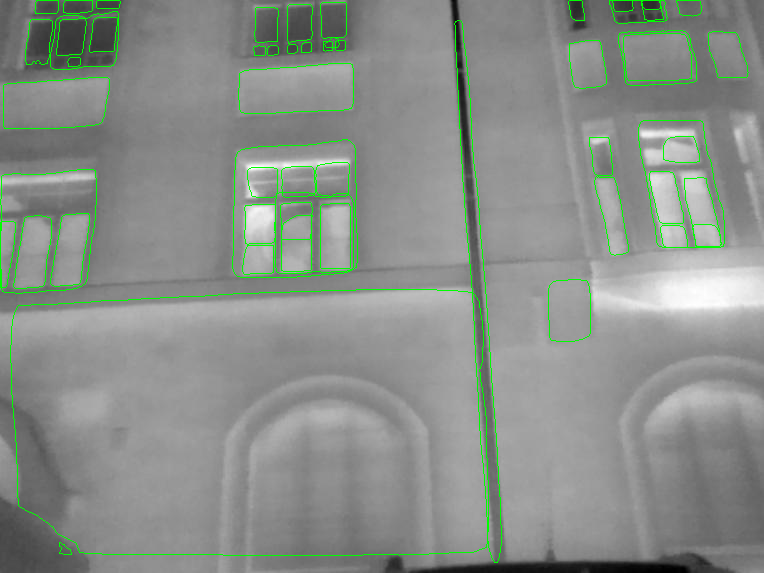

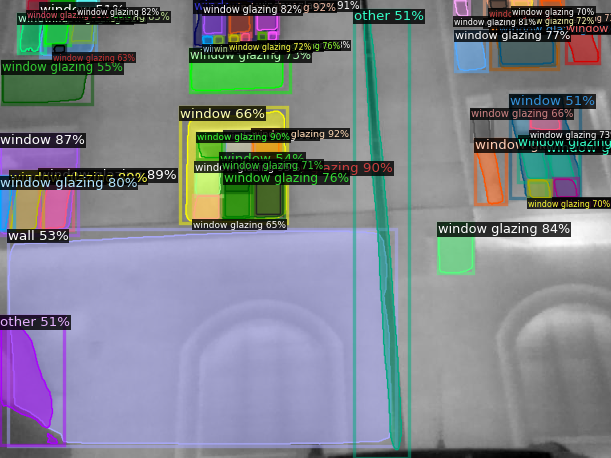

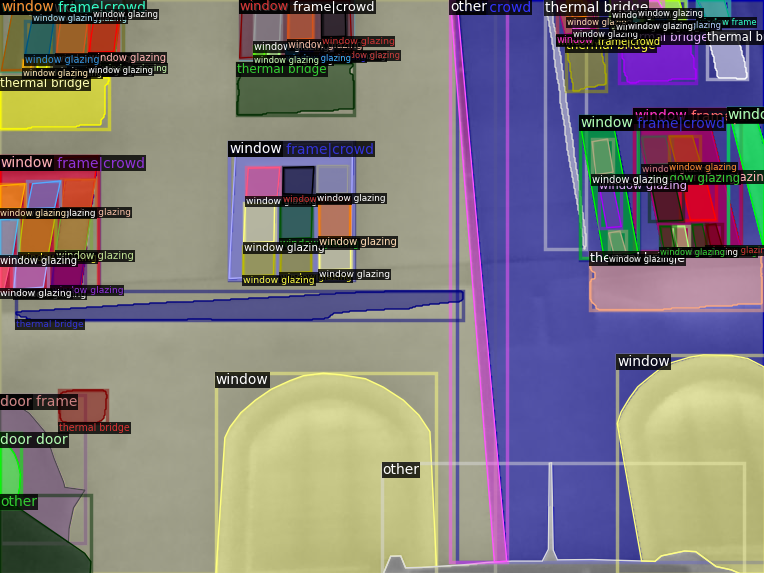

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/IR_561.jpg
tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3, 1, 3, 1, 9, 3, 1, 3, 1,
        3, 1, 1, 3, 1, 1, 1, 1, 3, 0], device='cuda:0')


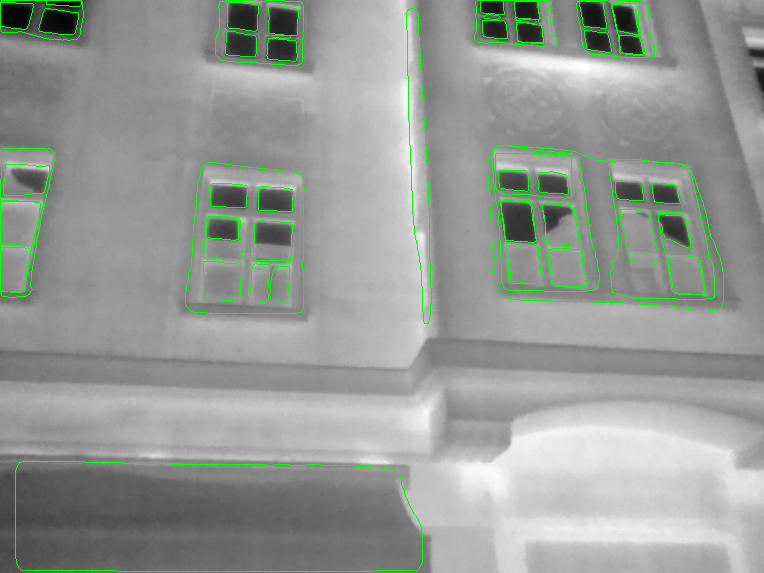

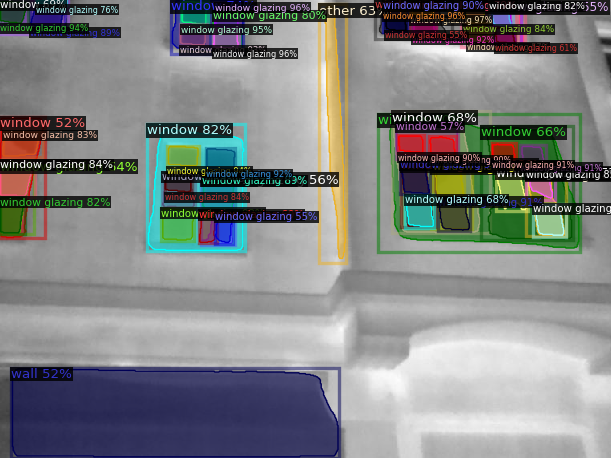

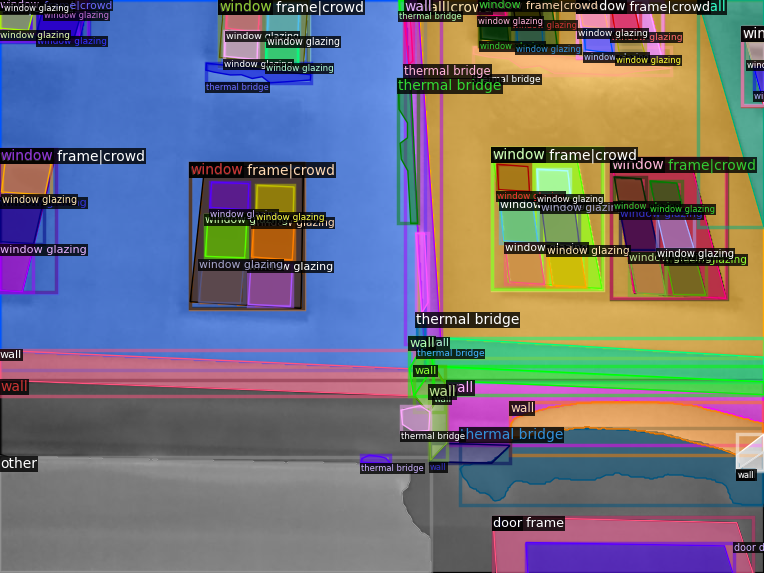

In [ ]:
#inference on validation data
dataset_dicts = DatasetCatalog.get("coco_dataset_val")

for d in random.sample(dataset_dicts, 2):
    print (d["file_name"])
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)

### added to find out how to obtain pixels from here: https://stackoverflow.com/questions/73217530/extract-the-masks-values-from-detectron2-object-detection-segmentation-and-then
    print(outputs["instances"].pred_classes)
    # print(outputs["instances"].pred_boxes)
    # print(outputs["instances"].scores)
    # print(outputs["instances"].pred_masks) just boolean
    # "outputs" is the inference output in the format described here - https://detectron2.readthedocs.io/tutorials/models.html#model-output-format

    # Extract the contour of each predicted mask and save it in a list
    contours = []

    for pred_mask in outputs["instances"].pred_masks:
    # pred_mask is of type torch.Tensor, and the values are boolean (True, False)
    # Convert it to a 8-bit numpy array, which can then be used to find contours
      mask = pred_mask.cpu().numpy().astype('uint8')
      contour, _ = cv2.findContours(mask, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
      #print(contour)
      contours.append(contour[0]) # contour is a tuple (OpenCV 4.5.2), so take the first element which is the array of contour points
    image_with_overlaid_predictions = img.copy()

    for contour in contours:
      cv2.drawContours(image_with_overlaid_predictions, [contour], -1, (0,255,0), 1)
    cv2_imshow(image_with_overlaid_predictions)
    # write text file
    with open('contours.txt', 'w') as f:
      f.writelines(str(outputs["instances"].pred_masks.size()))
###

    v = Visualizer(img[:, :, ::-1],
                  metadata=my_dataset_train_metadata,
                  scale=0.8
                  )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])
    visualizer = Visualizer(img[:, :, ::-1],
                            metadata=my_dataset_train_metadata,
                            scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

### Inference on test dataset

[03/15 11:07:54 d2.data.datasets.coco]: Loaded 4 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test/output.json
/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test/IR_551.jpg


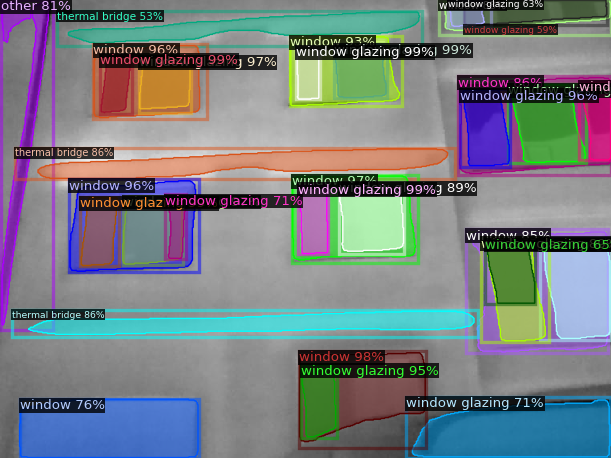

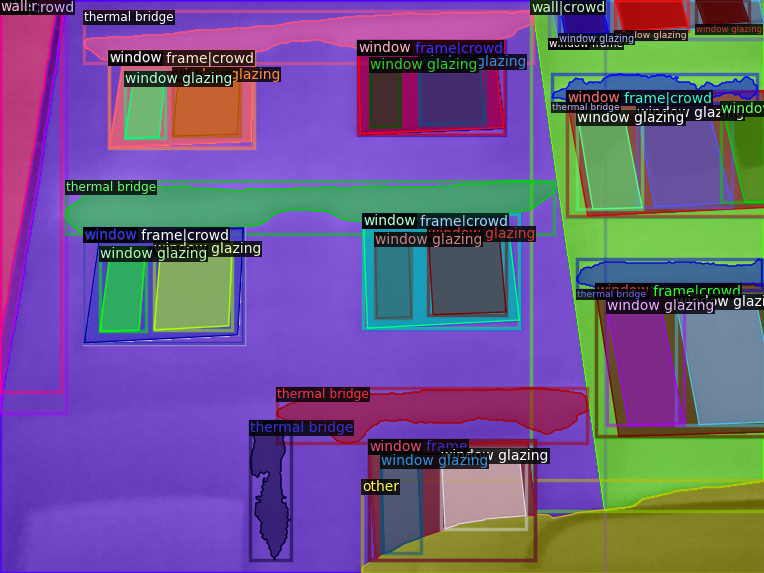

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test/IR_571.jpg


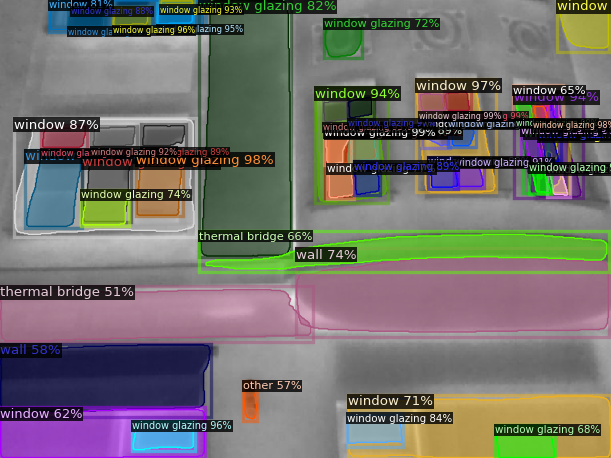

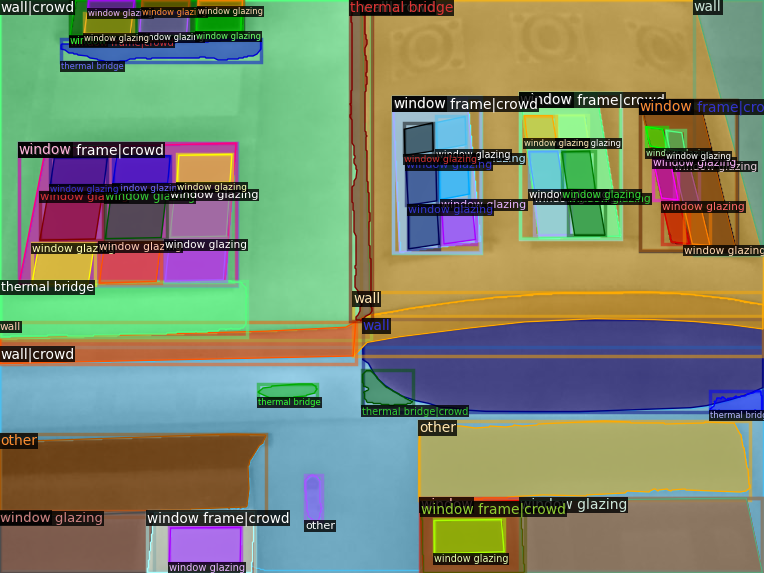

In [ ]:
#inference on test data
dataset_dicts = DatasetCatalog.get("coco_dataset_test")

for d in random.sample(dataset_dicts, 2):
    print (d["file_name"])
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)

    v = Visualizer(img[:, :, ::-1],
                  metadata=my_dataset_train_metadata,
                  scale=0.8
                  )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])
    visualizer = Visualizer(img[:, :, ::-1],
                            metadata=my_dataset_train_metadata,
                            scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

### Resume training

In [ ]:
cfg.SOLVER.MAX_ITER = 1000    # increase iterations

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=True)
trainer.train()

[03/14 19:22:01 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

### Inference on validation dataset

In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything previously set. Changed for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the current model
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # custom testing threshold
predictor = DefaultPredictor(cfg)

[03/15 10:13:16 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


In [ ]:
#inference on validation data
dataset_dicts = DatasetCatalog.get("coco_dataset_val")

for d in random.sample(dataset_dicts, 2):
    print (d["file_name"])
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)

### added to find out how to obtain pixels from here: https://stackoverflow.com/questions/73217530/extract-the-masks-values-from-detectron2-object-detection-segmentation-and-then
    print(outputs["instances"].pred_classes)
    # print(outputs["instances"].pred_boxes)
    # print(outputs["instances"].scores)
    # print(outputs["instances"].pred_masks) just boolean
    # "outputs" is the inference output in the format described here - https://detectron2.readthedocs.io/tutorials/models.html#model-output-format

    # Extract the contour of each predicted mask and save it in a list
    contours = []

    for pred_mask in outputs["instances"].pred_masks:
    # pred_mask is of type torch.Tensor, and the values are boolean (True, False)
    # Convert it to a 8-bit numpy array, which can then be used to find contours
      mask = pred_mask.cpu().numpy().astype('uint8')
      contour, _ = cv2.findContours(mask, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
      #print(contour)
      contours.append(contour[0]) # contour is a tuple (OpenCV 4.5.2), so take the first element which is the array of contour points
    image_with_overlaid_predictions = img.copy()

    for contour in contours:
      cv2.drawContours(image_with_overlaid_predictions, [contour], -1, (0,255,0), 1)
    cv2_imshow(image_with_overlaid_predictions)
    # write text file
    with open('contours.txt', 'w') as f:
      f.writelines(str(outputs["instances"].pred_masks.size()))
###

    v = Visualizer(img[:, :, ::-1],
                  metadata=my_dataset_train_metadata,
                  scale=0.8
                  )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])
    visualizer = Visualizer(img[:, :, ::-1],
                            metadata=my_dataset_train_metadata,
                            scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

[03/20 13:04:50 d2.data.datasets.coco]: Loaded 6 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/output.json
/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/IR_395.jpg


NameError: name 'predictor' is not defined

### Inference on test dataset

[03/15 10:14:12 d2.data.datasets.coco]: Loaded 4 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test/output.json
/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test/IR_398.jpg


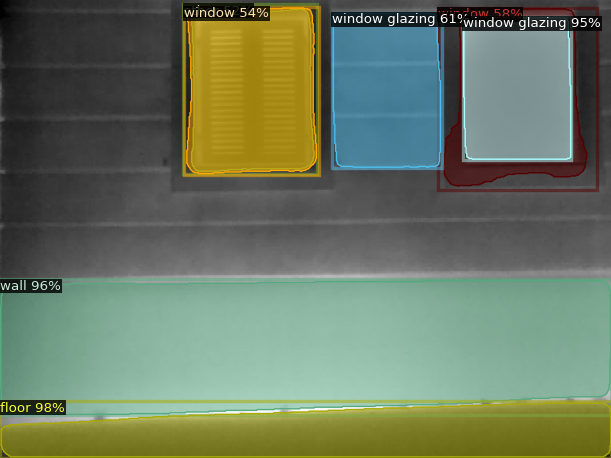

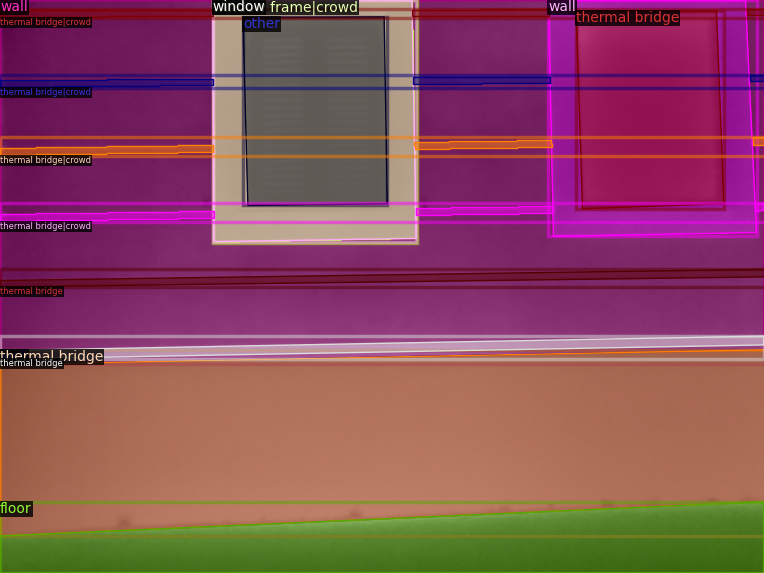

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test/IR_551.jpg


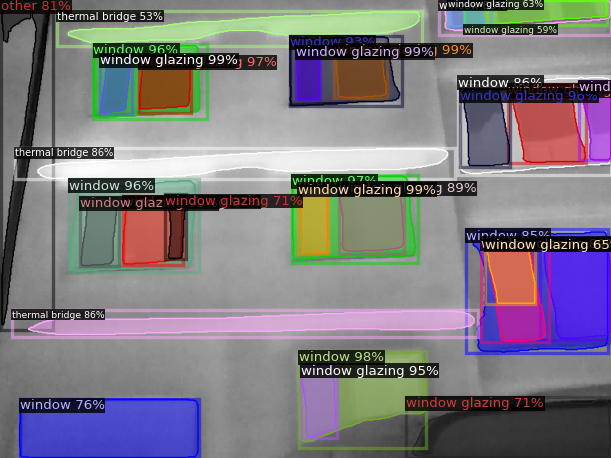

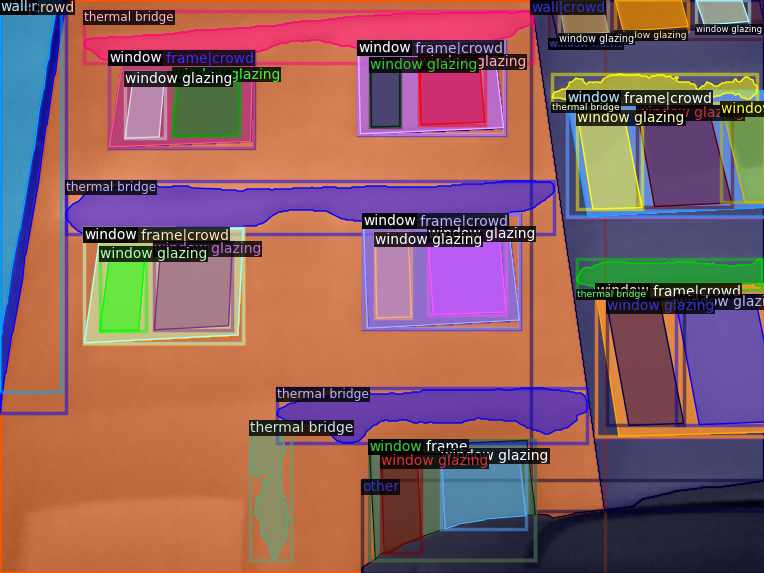

In [ ]:
#inference on test data
dataset_dicts = DatasetCatalog.get("coco_dataset_test")

for d in random.sample(dataset_dicts, 2):
    print (d["file_name"])
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)

    v = Visualizer(img[:, :, ::-1],
                  metadata=my_dataset_train_metadata,
                  scale=0.8
                  )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])
    visualizer = Visualizer(img[:, :, ::-1],
                            metadata=my_dataset_train_metadata,
                            scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

### Training curves

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 10439), started 0:29:04 ago. (Use '!kill 10439' to kill it.)

<IPython.core.display.Javascript object>

### Save the model

In [ ]:
modelversion = '20240314_notransforms_2000'
modelname = "instancethermal_"+modelversion+'.pth'
print(modelname)

instancethermal_20240314_notransforms_1000.pth


In [ ]:
# Save the model
checkpointer = DetectionCheckpointer(trainer.model, save_dir=cfg.OUTPUT_DIR)
checkpointer.save(modelname[:-4])

In [ ]:
# Copy the model to google drive
import shutil

shutil.copy(os.path.join(cfg.OUTPUT_DIR, modelname),os.path.join("/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/output", modelname))

'/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/output/instancethermal_20240314_notransforms_1000.pth'

## Transformations


### Train the model with transformations

In [ ]:
#  Fine-tuning a COCO-pretrained R50-FPN Mask R-CNN model on the dataset

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ('coco_dataset_train',)
cfg.DATASETS.TEST = ('coco_dataset_val',)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4  # This is the real "batch size"
cfg.SOLVER.BASE_LR = 0.0005
cfg.SOLVER.MAX_ITER = 4000
cfg.SOLVER.STEPS = (4200, 4500)
# cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # The "RoIHead batch size". 128 is faster, and good enough for this dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = len(MetadataCatalog.get('coco_dataset_train').thing_classes)

In [ ]:
class MyTrainer(DefaultTrainer):

    @classmethod
    def build_train_loader(cls, cfg):
        mapper = DatasetMapper(cfg, is_train=True, augmentations=
         [T.RandomCrop('relative_range', [0.5,0.5]),
          T.RandomBrightness(0.8, 1.8),
          T.RandomContrast(0.6, 1.3),
          T.RandomSaturation(0.8, 1.4),
          # T.RandomRotation(angle=[90, 90]),
          T.RandomLighting(0.7),
          T.RandomFlip(prob=0.5, horizontal=True, vertical=False),])
        return build_detection_train_loader(cfg, mapper=mapper)

In [ ]:
cfg.SOLVER.MAX_ITER = 4000    # increase iterations

# Instantiate the trainer and train the model
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = MyTrainer(cfg) #using CustomTrainer which contains data augmentation instead of DefaultTrainer
trainer.resume_or_load(resume=True)
trainer.train()

[03/20 15:15:53 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[03/20 15:15:54 d2.engine.train_loop]: Starting training from iteration 0
[03/20 15:16:16 d2.utils.events]:  eta: 1:05:48  iter: 19  total_loss: 6.82  loss_cls: 2.296  loss_box_reg: 0.637  loss_mask: 0.6926  loss_rpn_cls: 2.885  loss_rpn_loc: 0.4515    time: 1.0233  last_time: 0.8298  data_time: 0.2830  last_data_time: 0.0264   lr: 9.9905e-06  max_mem: 4133M
[03/20 15:16:33 d2.utils.events]:  eta: 0:56:40  iter: 39  total_loss: 6.116  loss_cls: 1.99  loss_box_reg: 0.6188  loss_mask: 0.6866  loss_rpn_cls: 2.314  loss_rpn_loc: 0.4825    time: 0.9339  last_time: 0.7330  data_time: 0.0207  last_data_time: 0.0239   lr: 1.998e-05  max_mem: 4299M
[03/20 15:16:51 d2.utils.events]:  eta: 0:56:30  iter: 59  total_loss: 4.214  loss_cls: 1.615  loss_box_reg: 0.633  loss_mask: 0.6767  loss_rpn_cls: 0.8745  loss_rpn_loc: 0.4778    time: 0.9160  last_time: 1.0470  data_time: 0.0223  last_data_time: 0.0382   lr: 2.997e-05  max_mem: 4299M
[03/20 15:17:09 d2.utils.events]:  eta: 0:55:59  iter: 79  total

### Evaluate model

In [ ]:
# Evaluate the model on validation dataset
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
evaluator = COCOEvaluator('coco_dataset_val', cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, 'coco_dataset_val')
inference_on_dataset(trainer.model, val_loader, evaluator)

In [ ]:
# Evaluate the model on test dataset
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
evaluator = COCOEvaluator('coco_dataset_test', cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, 'coco_dataset_test')
inference_on_dataset(trainer.model, val_loader, evaluator)

In [ ]:
# Evaluate the model on training dataset
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
evaluator = COCOEvaluator('coco_dataset_train', cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, 'coco_dataset_train')
inference_on_dataset(trainer.model, val_loader, evaluator)

In [ ]:
# Evaluate the model on full dataset
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
evaluator = COCOEvaluator('coco_dataset_all', cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, 'coco_dataset_all')
inference_on_dataset(trainer.model, val_loader, evaluator)

### Inference on validation dataset

In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything previously set. Changed for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the current model
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # custom testing threshold
predictor = DefaultPredictor(cfg)

In [ ]:
#inference on validation data
dataset_dicts = DatasetCatalog.get("coco_dataset_val")

for d in random.sample(dataset_dicts, 6):
    print (d["file_name"])
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)

### added to find out how to obtain pixels from here: https://stackoverflow.com/questions/73217530/extract-the-masks-values-from-detectron2-object-detection-segmentation-and-then
    print(outputs["instances"].pred_classes)
    # print(outputs["instances"].pred_boxes)
    # print(outputs["instances"].scores)
    # print(outputs["instances"].pred_masks) just boolean
    # "outputs" is the inference output in the format described here - https://detectron2.readthedocs.io/tutorials/models.html#model-output-format

    # Extract the contour of each predicted mask and save it in a list
    contours = []

    for pred_mask in outputs["instances"].pred_masks:
    # pred_mask is of type torch.Tensor, and the values are boolean (True, False)
    # Convert it to a 8-bit numpy array, which can then be used to find contours
      mask = pred_mask.cpu().numpy().astype('uint8')
      contour, _ = cv2.findContours(mask, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
      #print(contour)
      contours.append(contour[0]) # contour is a tuple (OpenCV 4.5.2), so take the first element which is the array of contour points
    image_with_overlaid_predictions = img.copy()

    for contour in contours:
      cv2.drawContours(image_with_overlaid_predictions, [contour], -1, (0,255,0), 1)
    cv2_imshow(image_with_overlaid_predictions)
    # write text file
    with open('contours.txt', 'w') as f:
      f.writelines(str(outputs["instances"].pred_masks.size()))
###

    v = Visualizer(img[:, :, ::-1],
                  metadata=my_dataset_train_metadata,
                  scale=1
                  )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])
    visualizer = Visualizer(img[:, :, ::-1],
                            metadata=my_dataset_train_metadata,
                            scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

### Inference on test dataset

In [ ]:
#inference on test data
dataset_dicts = DatasetCatalog.get("coco_dataset_test")

for d in random.sample(dataset_dicts, 4):
    print (d["file_name"])
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)

    v = Visualizer(img[:, :, ::-1],
                  metadata=my_dataset_train_metadata,
                  scale=1
                  )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])
    visualizer = Visualizer(img[:, :, ::-1],
                            metadata=my_dataset_train_metadata,
                            scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

### Training curves

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

### Save the model

In [ ]:
modelversion = '20240320_transforms_4000_v2'
modelname = "instancethermal_"+modelversion+'.pth'
print(modelname)

In [ ]:
# Save the model
checkpointer = DetectionCheckpointer(trainer.model, save_dir=cfg.OUTPUT_DIR)
checkpointer.save(modelname[:-4])

In [ ]:
# Copy the model to google drive
import shutil

shutil.copy(os.path.join(cfg.OUTPUT_DIR, modelname),os.path.join("/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/output", modelname))

## Full dataset

### Fine-tuning

In [ ]:
#  Fine-tuning a COCO-pretrained R50-FPN Mask R-CNN model on the dataset

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ('coco_dataset_all',)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4  # This is the real "batch size"
cfg.SOLVER.BASE_LR = 0.0005
cfg.SOLVER.MAX_ITER = 2000
cfg.SOLVER.STEPS = (4000, 4500)
# cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # The "RoIHead batch size". 128 is faster, and good enough for this dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = len(MetadataCatalog.get('coco_dataset_all').thing_classes)

### Train using transformations

In [ ]:
cfg.SOLVER.MAX_ITER = 4000    # increase iterations
cfg.DATASETS.TRAIN = ('coco_dataset_all',)

# Instantiate the trainer and train the model
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = MyTrainer(cfg) #using CustomTrainer which contains data augmentation instead of DefaultTrainer
trainer.resume_or_load(resume=True)
trainer.train()

[03/20 14:39:14 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

### Training curves

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 11687), started 0:38:19 ago. (Use '!kill 11687' to kill it.)

<IPython.core.display.Javascript object>

### Evaluate model on training data

In [ ]:
# Evaluate the model on full dataset
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
evaluator = COCOEvaluator('coco_dataset_all', cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, 'coco_dataset_all')
inference_on_dataset(trainer.model, val_loader, evaluator)

[03/20 15:09:24 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [03/20 15:09:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[03/20 15:09:24 d2.data.datasets.coco]: Loaded 40 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/output.json
[03/20 15:09:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[03/20 15:09:24 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[03/20 15:09:24 d2.data.common]: Serializing 40 elements to byte tensors and concatenating them all ...
[03/20 15:09:24 d2.data.common]: Serialized dataset takes 0.78 MiB
[03/20 15:09:24 d2.evaluation.evalua

OrderedDict([('bbox',
              {'AP': 36.61396383848763,
               'AP50': 50.31043901435615,
               'AP75': 41.96607779939406,
               'APs': 21.16924975936205,
               'APm': 26.11585094431988,
               'APl': 47.69244618152219,
               'AP-wall': 46.90457745125759,
               'AP-window glazing': 58.73253912917294,
               'AP-door': 29.46534653465347,
               'AP-window': 68.61670736028856,
               'AP-window frame': 2.8712871287128716,
               'AP-thermal bridge': 31.42090321648142,
               'AP-door frame': 0.0,
               'AP-floor': 58.0561333605888,
               'AP-door door': 22.07920792079208,
               'AP-other': 47.992936282928525}),
             ('segm',
              {'AP': 34.877572646485184,
               'AP50': 48.745485651172174,
               'AP75': 38.99133037992794,
               'APs': 18.1983937148613,
               'APm': 22.5027391304873,
               'APl':

### Inference on validation dataset

In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything previously set. Changed for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the current model
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # custom testing threshold
predictor = DefaultPredictor(cfg)

[03/20 15:09:33 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


[03/20 15:09:34 d2.data.datasets.coco]: Loaded 6 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/output.json
/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/IR_540.jpg
tensor([1, 1, 1, 1, 3, 1, 1, 1, 1, 3, 1, 1, 1, 3, 3, 3, 1, 1, 1, 3, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1, 5, 5, 5, 0, 1, 9, 1, 0, 0, 3,
        9, 0, 3, 3, 5, 1, 5, 1, 8, 0, 2, 1, 8, 0, 5, 5, 5, 1, 1, 1, 1, 1],
       device='cuda:0')


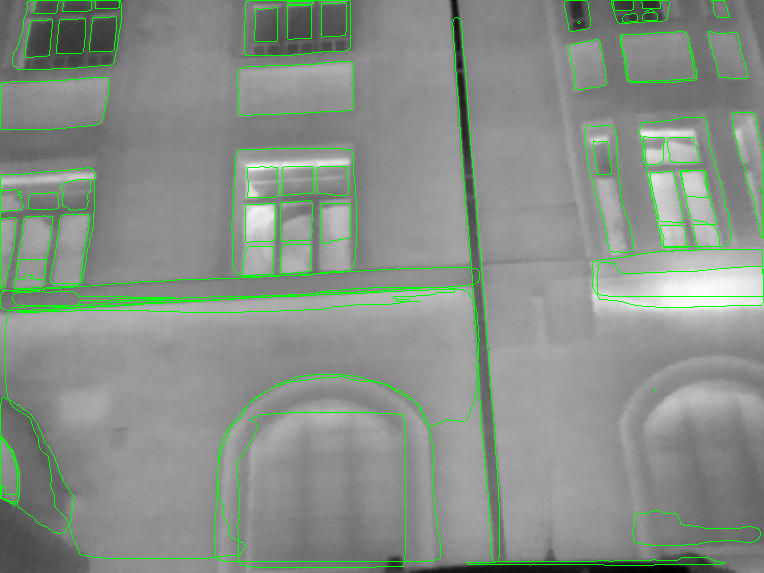

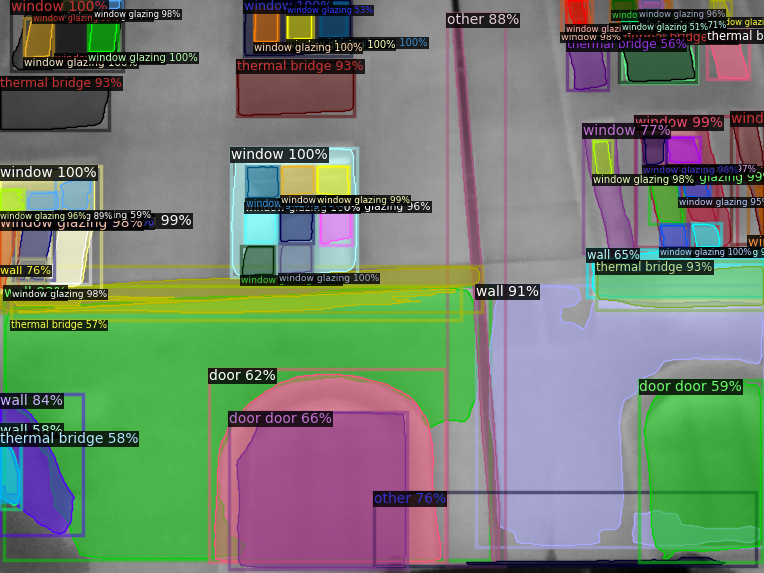

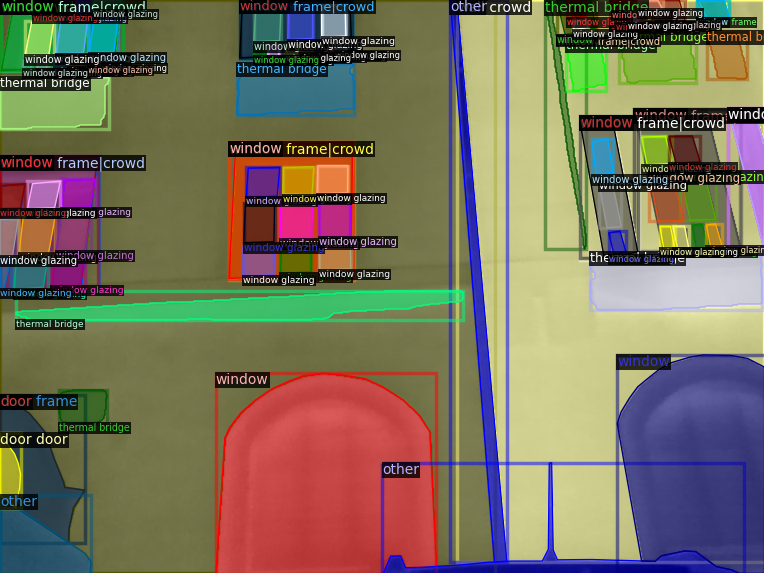

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/IR_561.jpg
tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 3, 1, 1,
        3, 3, 1, 3, 3, 1, 1, 1, 1, 3, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 3, 3, 0,
        5, 0, 0, 1, 5, 1, 0, 7, 1, 5, 0, 0, 1, 5, 0, 5], device='cuda:0')


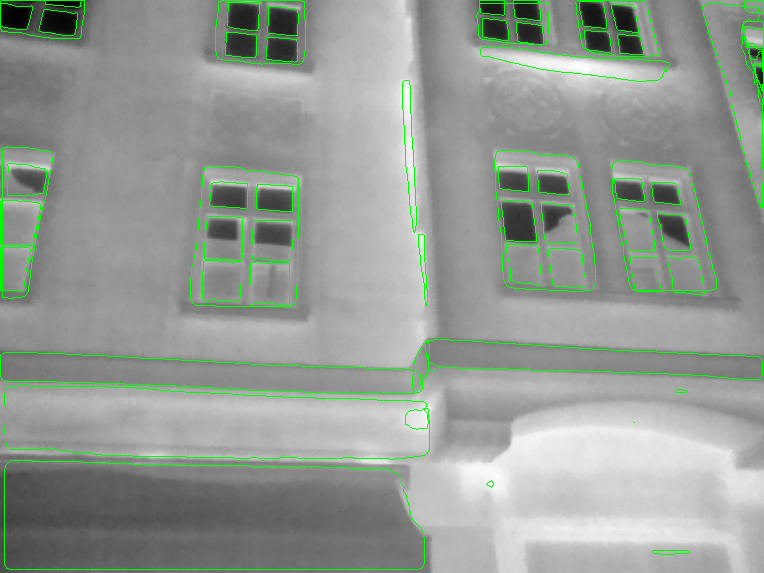

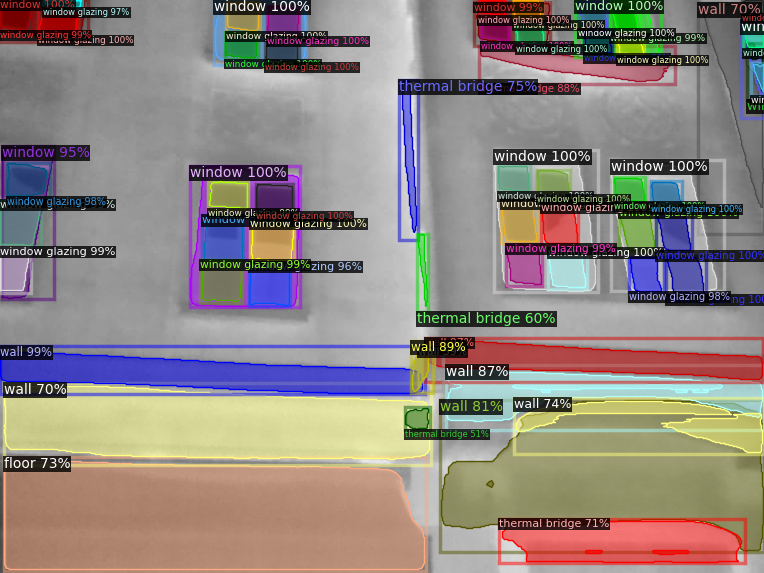

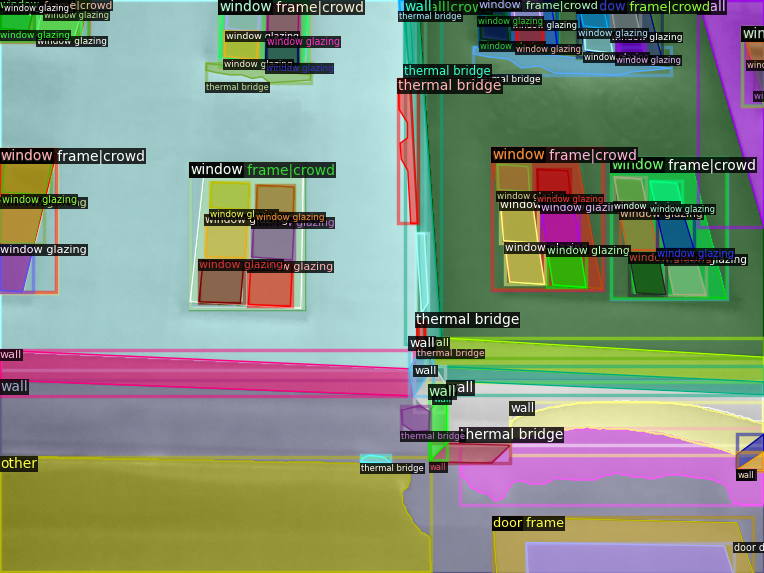

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/IR_550.jpg
tensor([1, 1, 1, 1, 3, 3, 3, 1, 1, 1, 3, 1, 3, 1, 1, 1, 1, 3, 1, 5, 1, 3, 3, 1,
        1, 5, 5, 1, 1, 5, 1, 9, 9, 5, 0, 5], device='cuda:0')


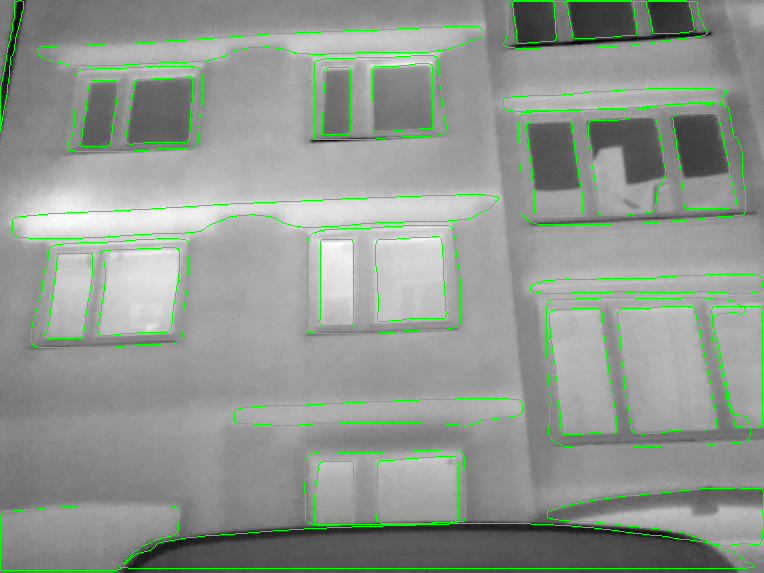

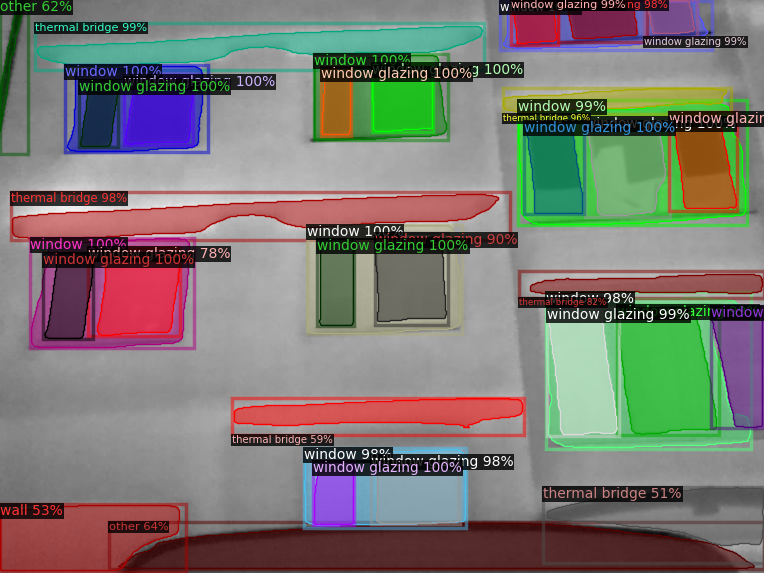

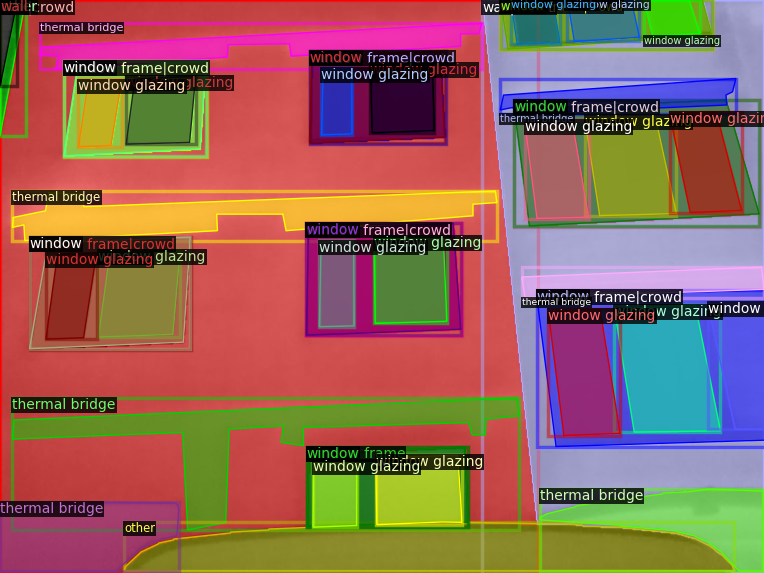

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/IR_396.jpg
tensor([1, 1, 3, 9, 1, 1, 0, 0, 1, 1, 9, 7, 9, 9, 5, 0, 3, 5, 0, 0, 9, 4, 5, 7],
       device='cuda:0')


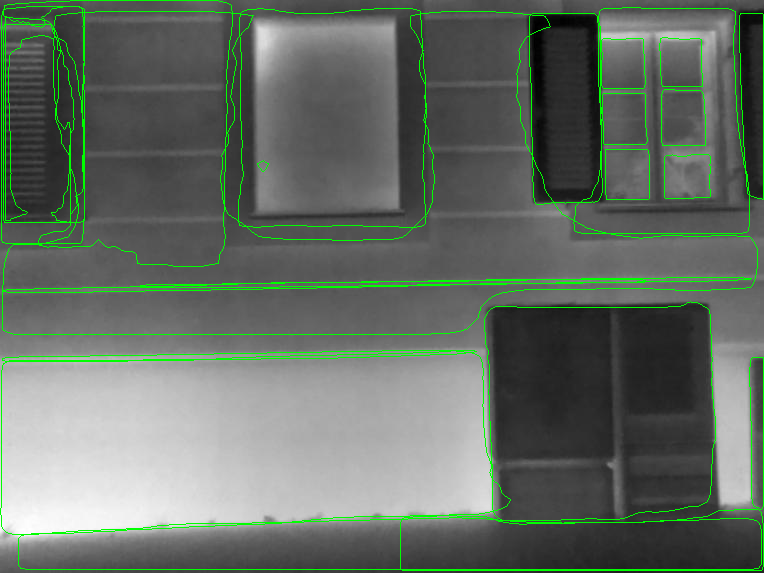

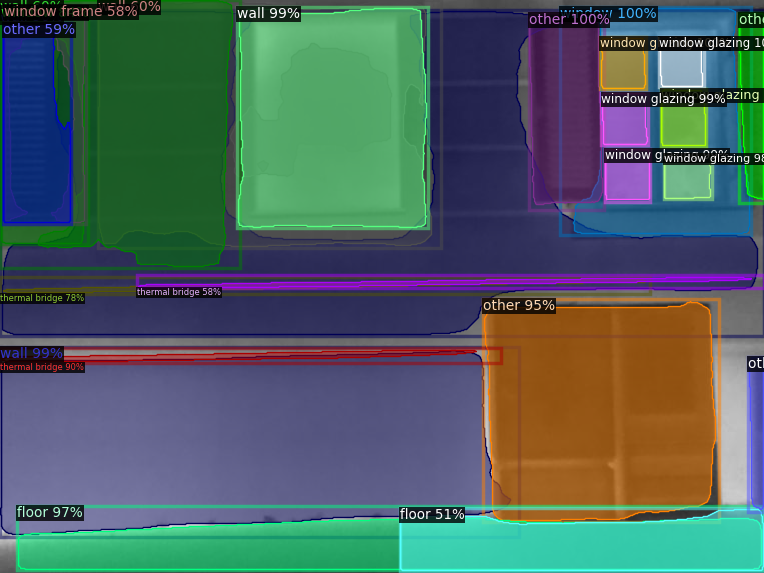

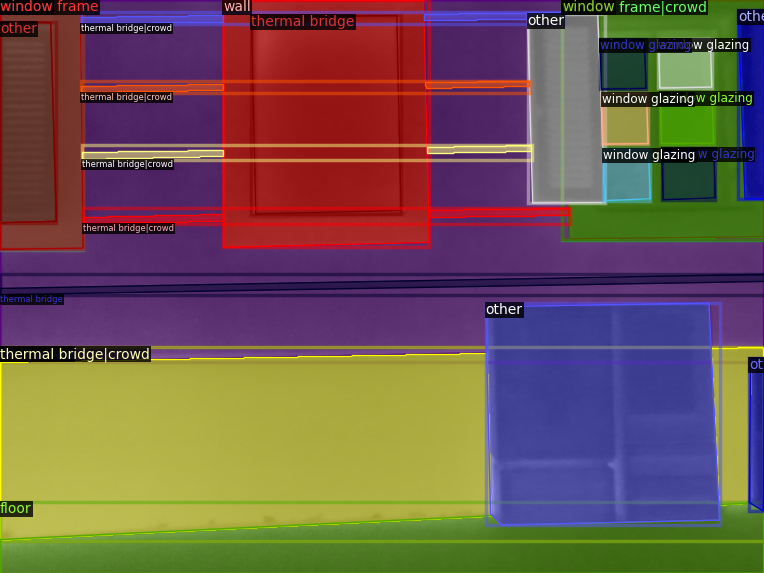

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/IR_397.jpg
tensor([0, 0, 7, 3, 0, 0, 9, 5, 5, 5], device='cuda:0')


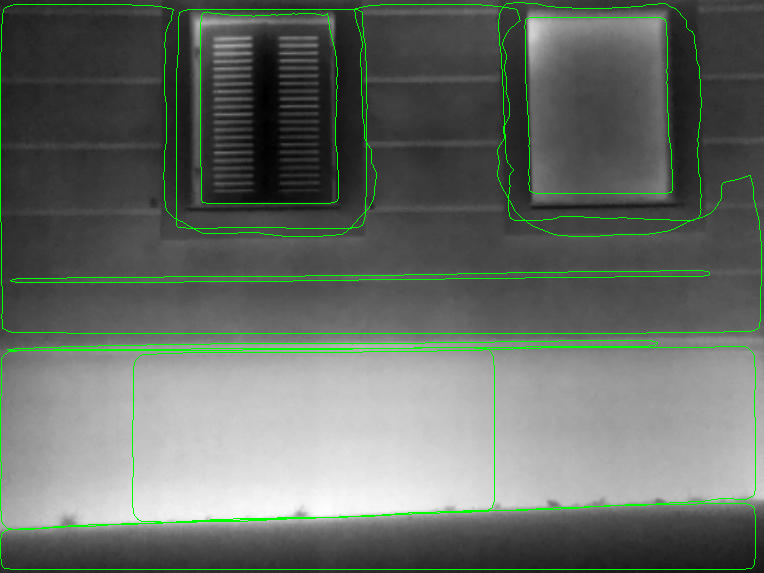

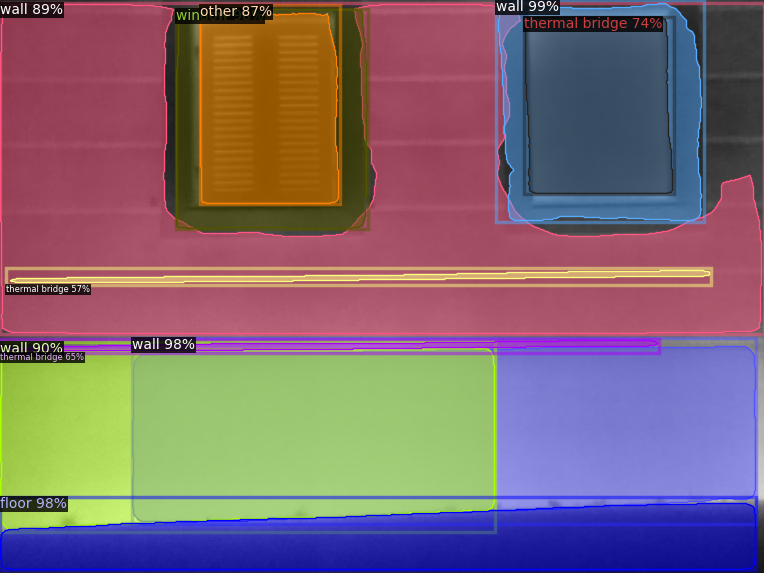

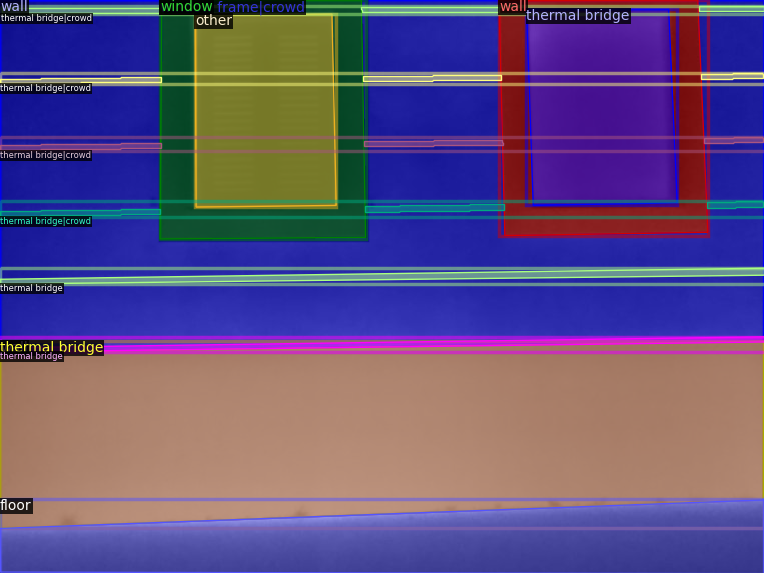

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/IR_395.jpg
tensor([1, 1, 1, 1, 3, 1, 1, 1, 3, 1, 9, 9, 3, 9, 0, 5, 5, 5, 1, 0, 1, 5, 9, 5,
        9, 1, 9, 3, 1, 9, 3, 5, 3, 5], device='cuda:0')


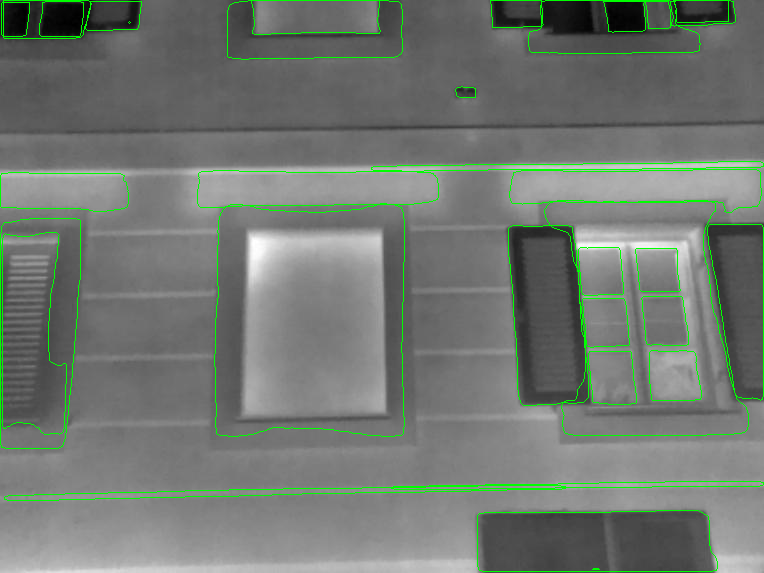

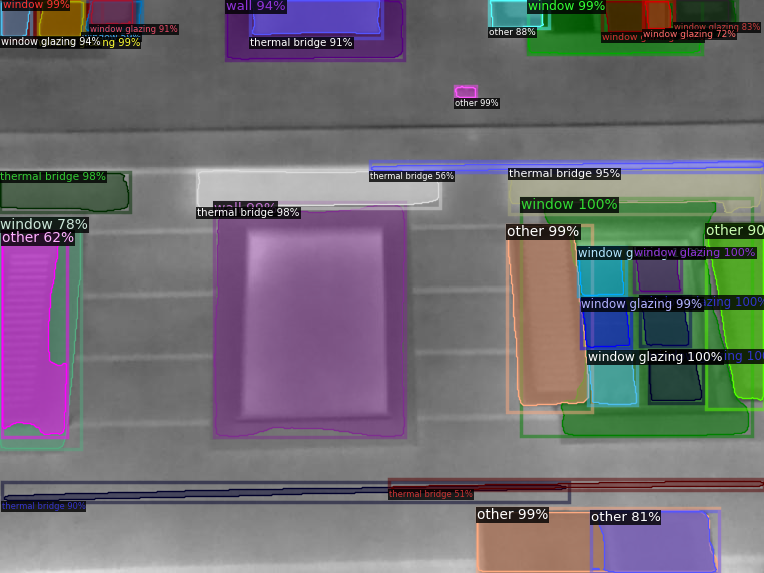

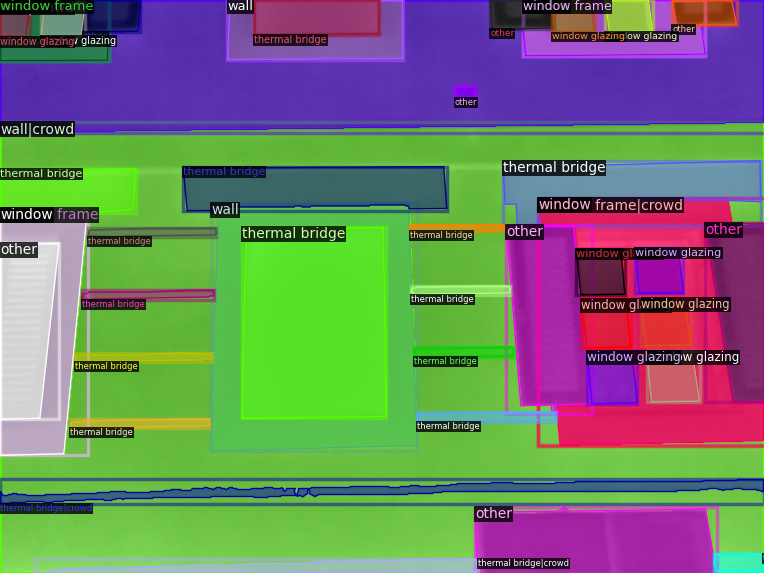

In [ ]:
#inference on validation data
dataset_dicts = DatasetCatalog.get("coco_dataset_val")

for d in random.sample(dataset_dicts, 6):
    print (d["file_name"])
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)

### added to find out how to obtain pixels from here: https://stackoverflow.com/questions/73217530/extract-the-masks-values-from-detectron2-object-detection-segmentation-and-then
    print(outputs["instances"].pred_classes)
    # print(outputs["instances"].pred_boxes)
    # print(outputs["instances"].scores)
    # print(outputs["instances"].pred_masks) just boolean
    # "outputs" is the inference output in the format described here - https://detectron2.readthedocs.io/tutorials/models.html#model-output-format

    # Extract the contour of each predicted mask and save it in a list
    contours = []

    for pred_mask in outputs["instances"].pred_masks:
    # pred_mask is of type torch.Tensor, and the values are boolean (True, False)
    # Convert it to a 8-bit numpy array, which can then be used to find contours
      mask = pred_mask.cpu().numpy().astype('uint8')
      contour, _ = cv2.findContours(mask, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
      #print(contour)
      contours.append(contour[0]) # contour is a tuple (OpenCV 4.5.2), so take the first element which is the array of contour points
    image_with_overlaid_predictions = img.copy()

    for contour in contours:
      cv2.drawContours(image_with_overlaid_predictions, [contour], -1, (0,255,0), 1)
    cv2_imshow(image_with_overlaid_predictions)
    # write text file
    with open('contours.txt', 'w') as f:
      f.writelines(str(outputs["instances"].pred_masks.size()))
###

    v = Visualizer(img[:, :, ::-1],
                  metadata=my_dataset_train_metadata,
                  scale=1
                  )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])
    visualizer = Visualizer(img[:, :, ::-1],
                            metadata=my_dataset_train_metadata,
                            scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

### Inference on test dataset

[03/20 15:09:47 d2.data.datasets.coco]: Loaded 4 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test/output.json
/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test/IR_571.jpg


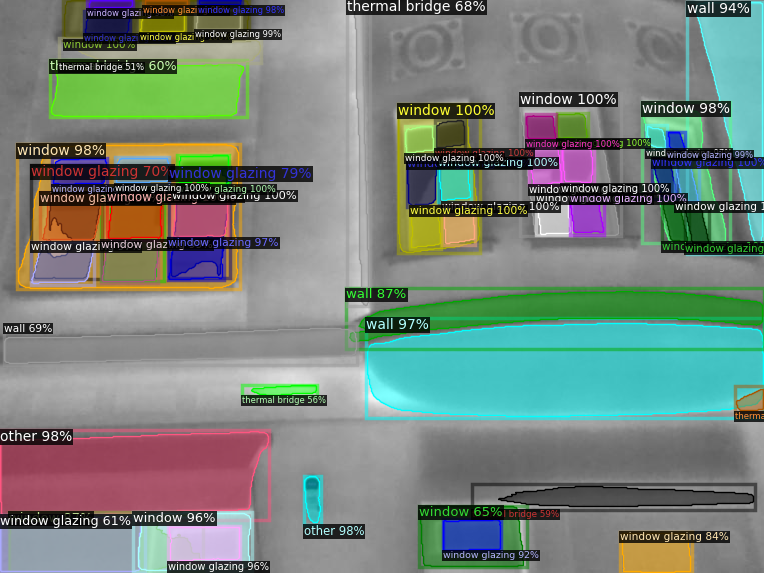

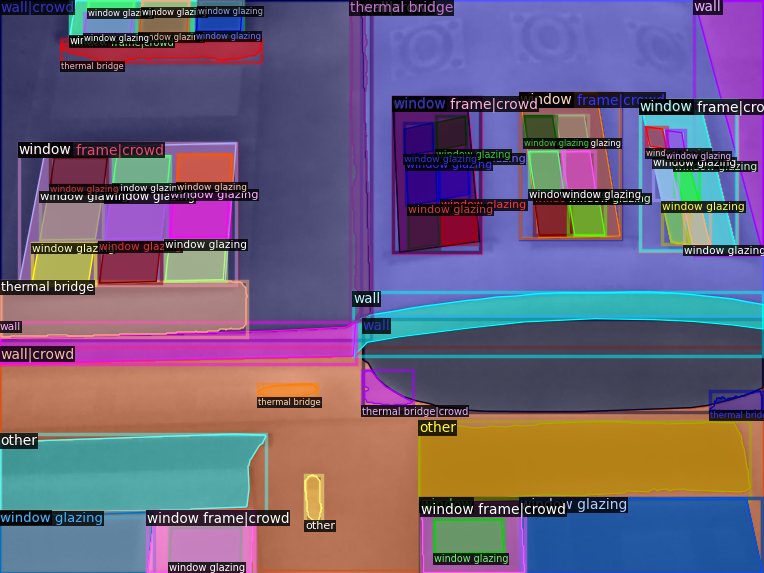

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test/IR_551.jpg


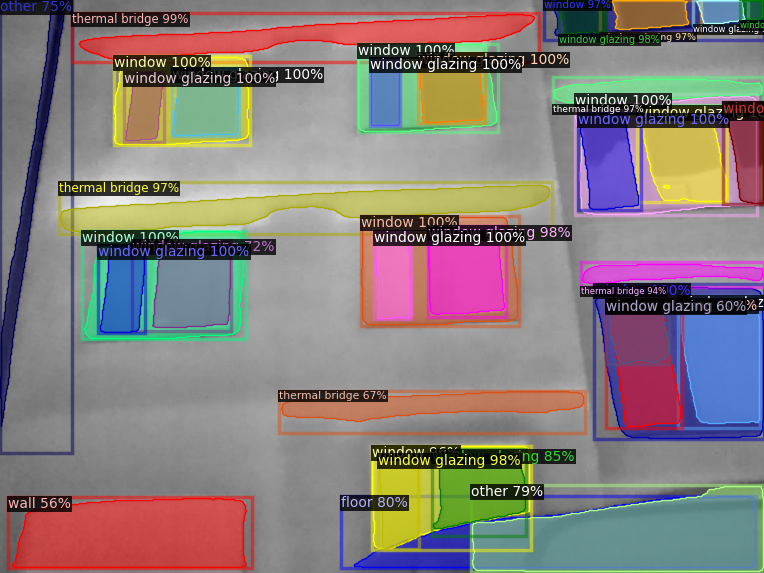

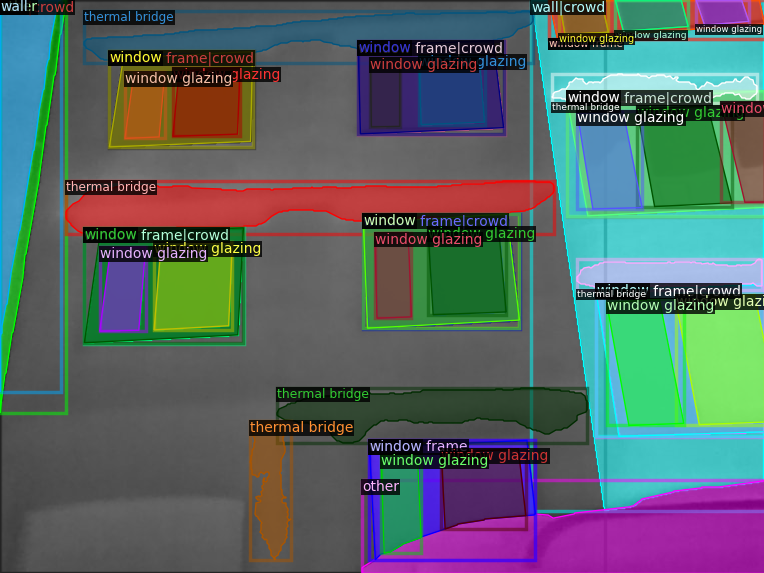

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test/IR_37.jpg


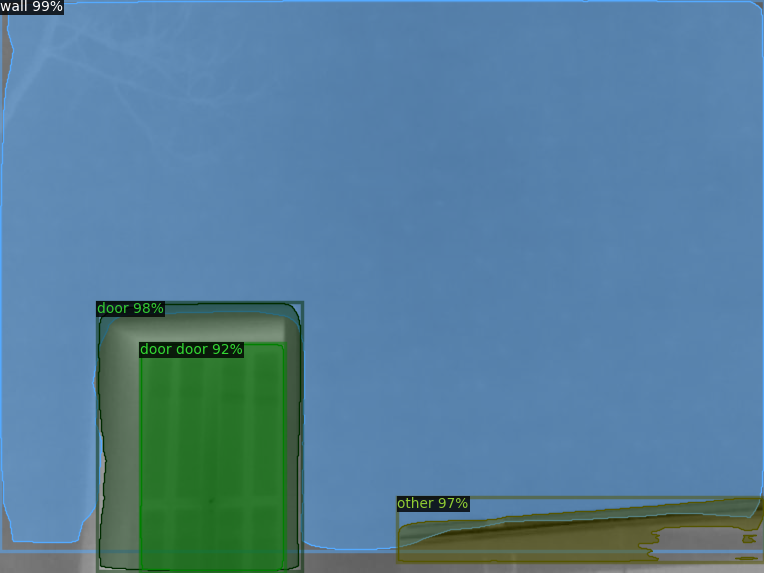

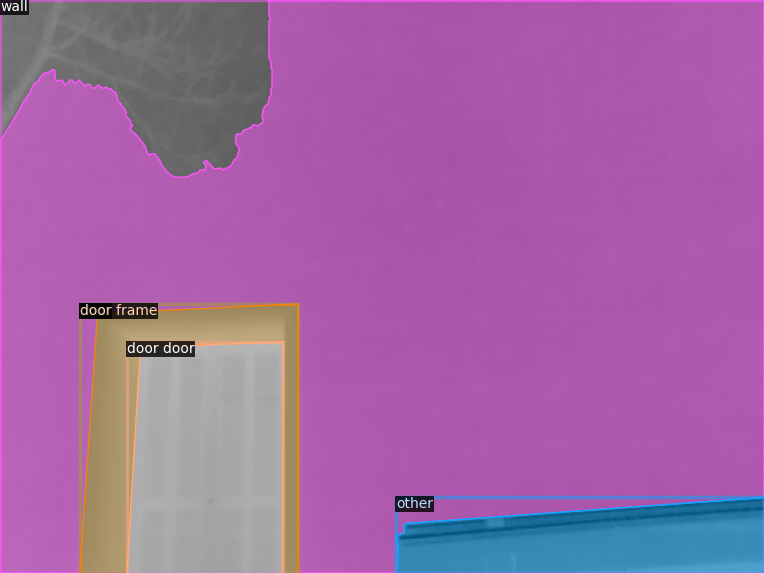

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test/IR_398.jpg


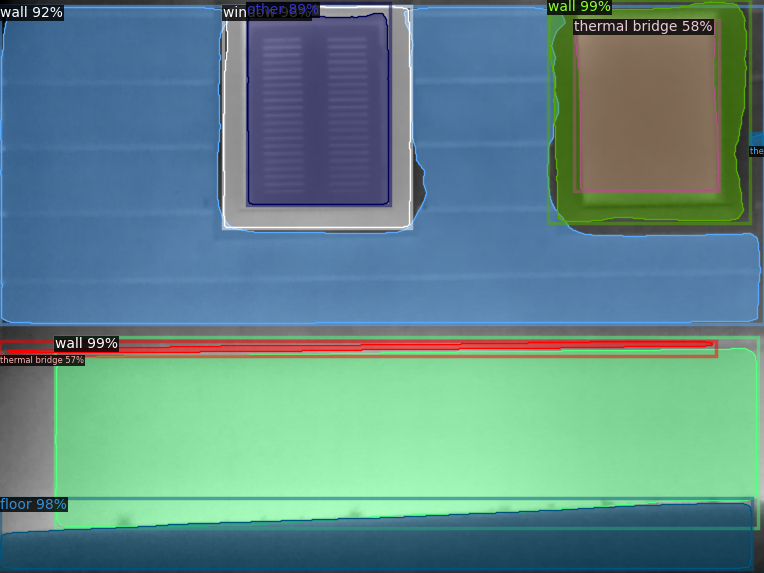

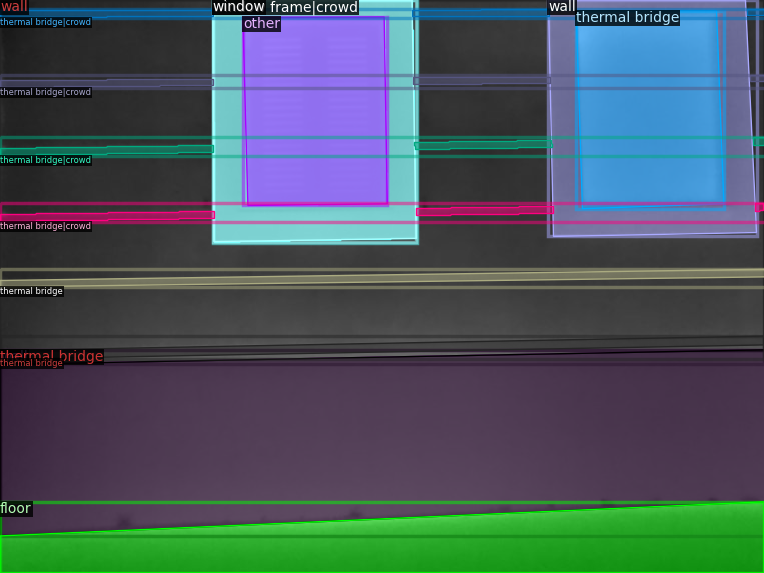

In [ ]:
#inference on test data
dataset_dicts = DatasetCatalog.get("coco_dataset_test")

for d in random.sample(dataset_dicts, 4):
    print (d["file_name"])
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)

    v = Visualizer(img[:, :, ::-1],
                  metadata=my_dataset_train_metadata,
                  scale=1
                  )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])
    visualizer = Visualizer(img[:, :, ::-1],
                            metadata=my_dataset_train_metadata,
                            scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

### Save the model

In [ ]:
modelversion = '20240320_transforms_4000_all'
modelname = "instancethermal_"+modelversion+'.pth'
print(modelname)

instancethermal_20240320_transforms_4000_all.pth


In [ ]:
# Save the model
checkpointer = DetectionCheckpointer(trainer.model, save_dir=cfg.OUTPUT_DIR)
checkpointer.save(modelname[:-4])

In [ ]:
# Copy the model to google drive
import shutil

shutil.copy(os.path.join(cfg.OUTPUT_DIR, modelname),os.path.join("/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/output", modelname))

'/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/output/instancethermal_20240320_transforms_4000_all.pth'

# Experiment Images

In [ ]:
# Register experiment sets directly from google drive
register_coco_instances("experiment_all", {}, "/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/validation/images/output.json", "/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/validation/images")
register_coco_instances("experiment_z1", {}, "/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/validation/images/z1/output.json", "/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/validation/images/z1")
register_coco_instances("experiment_z3", {}, "/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/validation/images/z3/output.json", "/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/validation/images/z3")

[03/20 14:35:07 d2.data.datasets.coco]: Loading /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/validation/images/output.json takes 1.57 seconds.
WARNING [03/20 14:35:07 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[03/20 14:35:07 d2.data.datasets.coco]: Loaded 5 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/validation/images/output.json


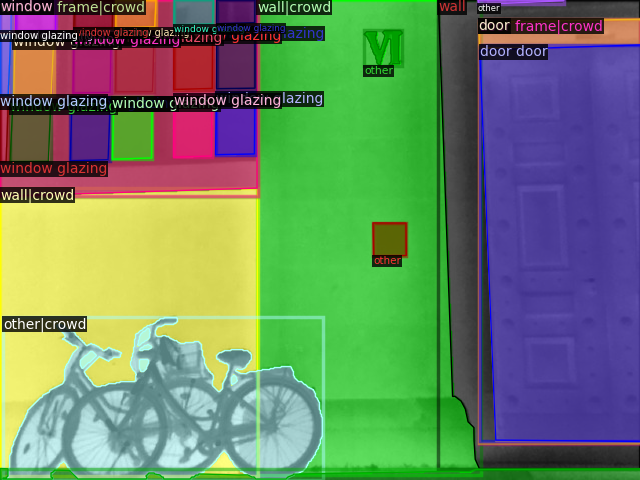

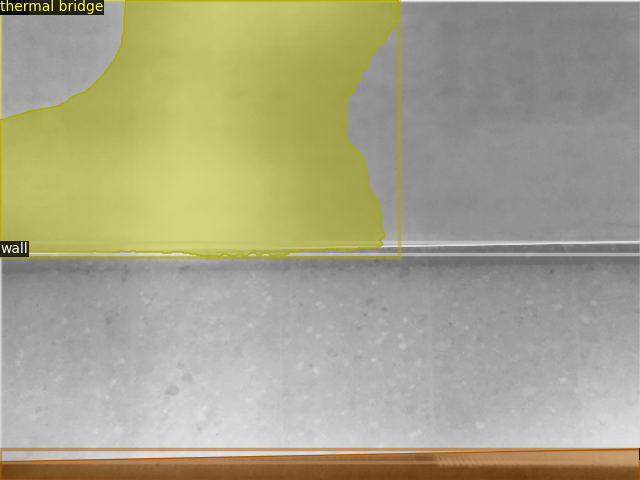

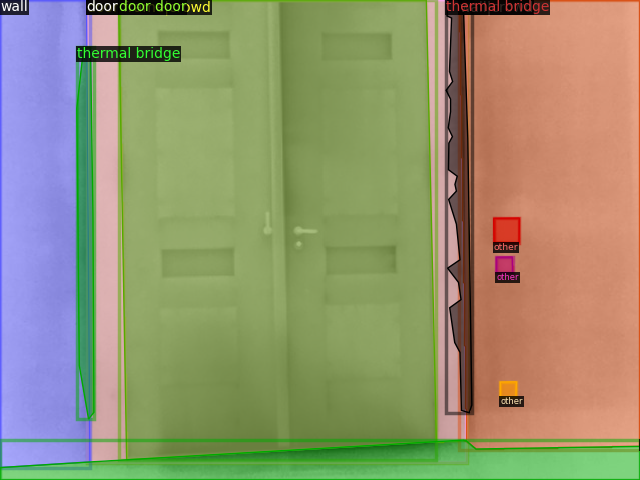

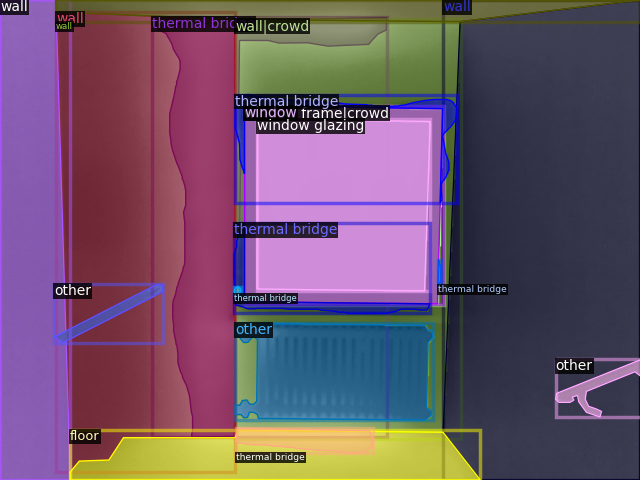

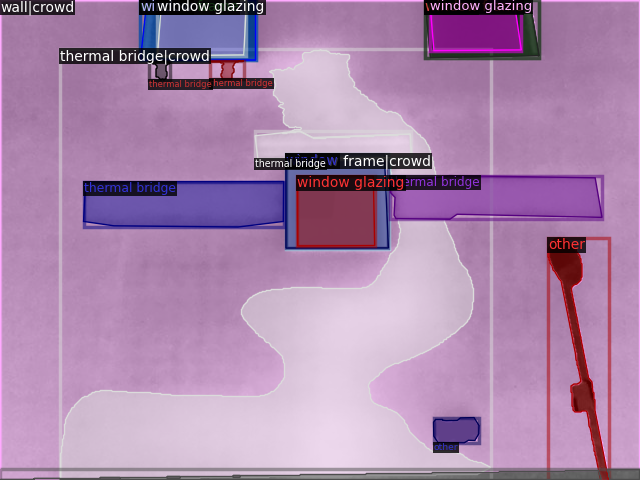

In [ ]:
# Visualize experiment data
my_dataset_train_metadata = MetadataCatalog.get("coco_dataset_train")
dataset_dicts = DatasetCatalog.get("experiment_all")

for d in random.sample(dataset_dicts, 5):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

## Inference on experiment images

WARNING [03/20 15:09:55 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[03/20 15:09:55 d2.data.datasets.coco]: Loaded 5 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/validation/images/output.json
/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/validation/images/img_20240224_043150_838.jpg


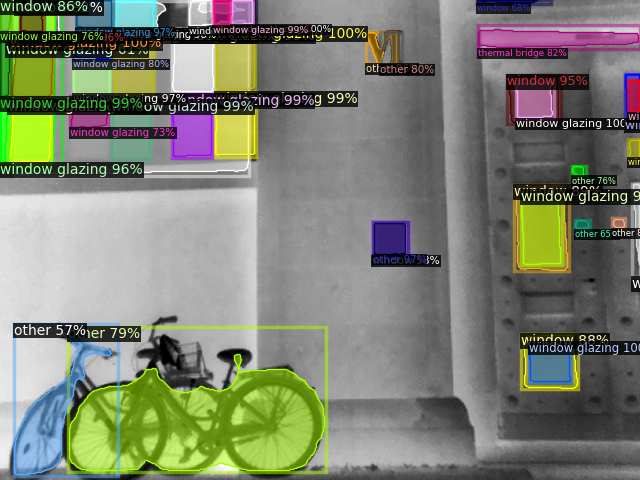

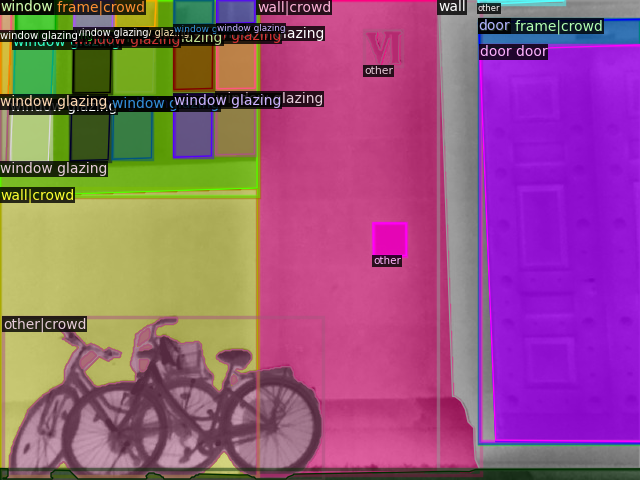

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/validation/images/img_20240224_053252_903.jpg


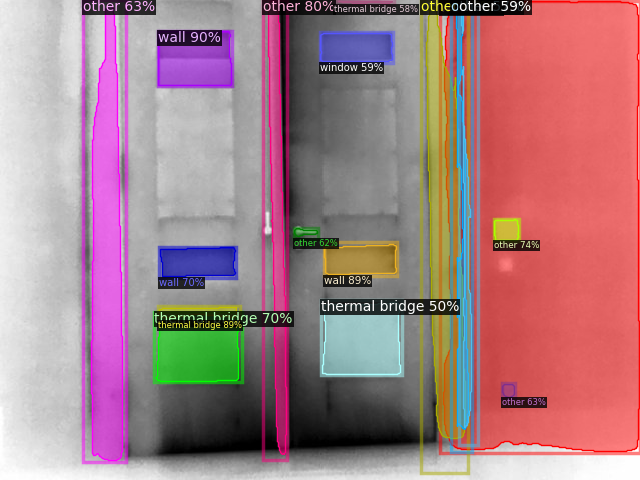

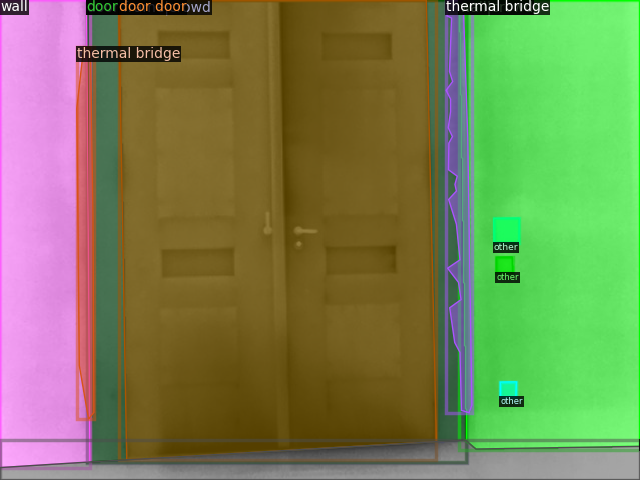

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/validation/images/img_20240224_051433_797.jpg


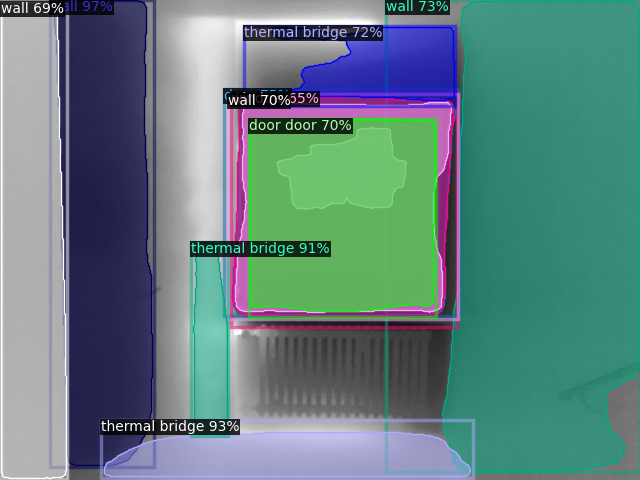

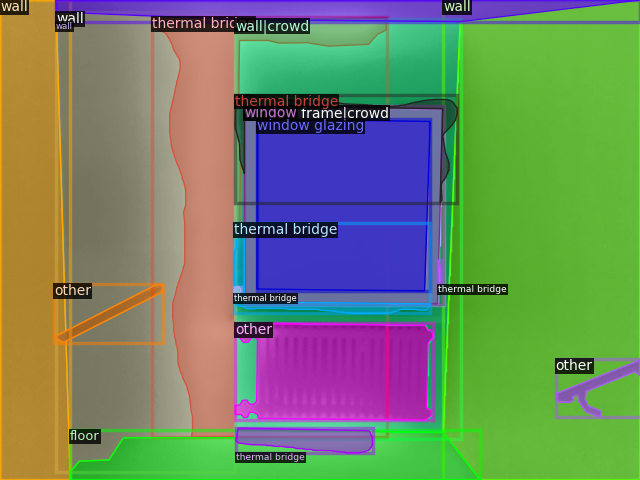

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/validation/images/img_20240224_044444_401.jpg


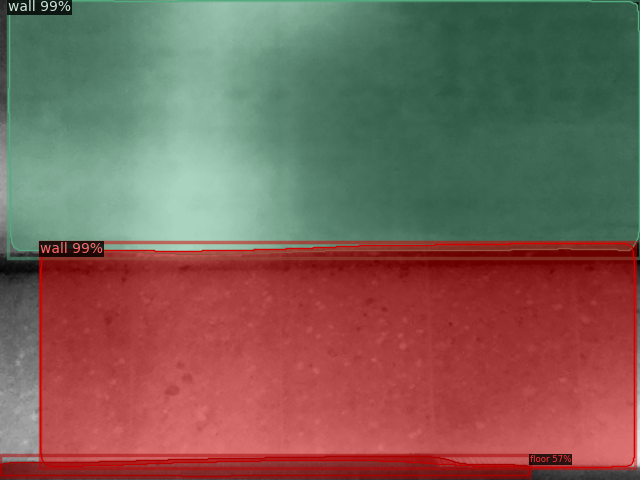

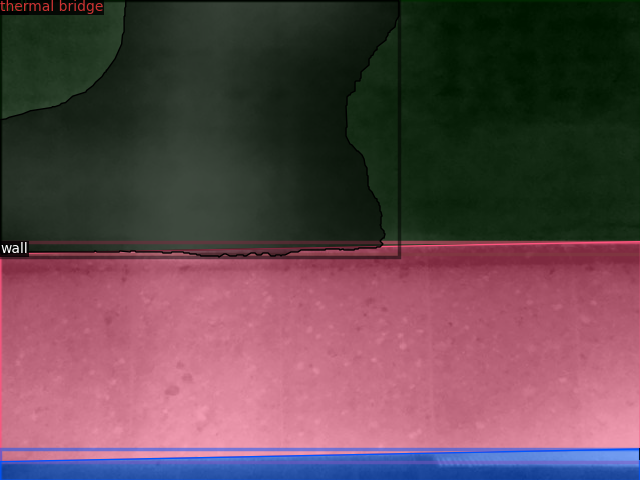

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/validation/images/img_20240224_045246_861.jpg


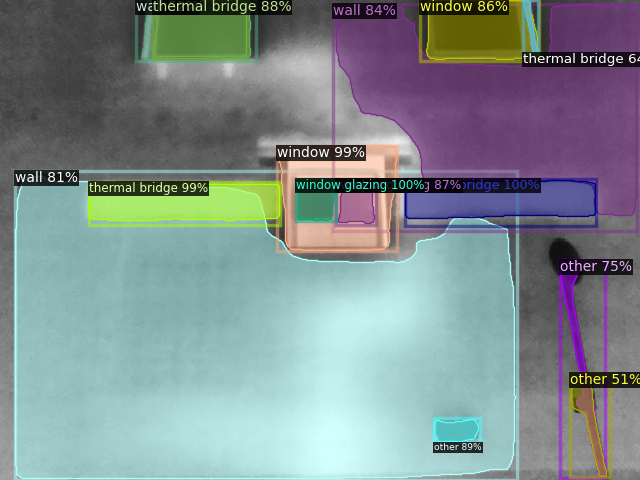

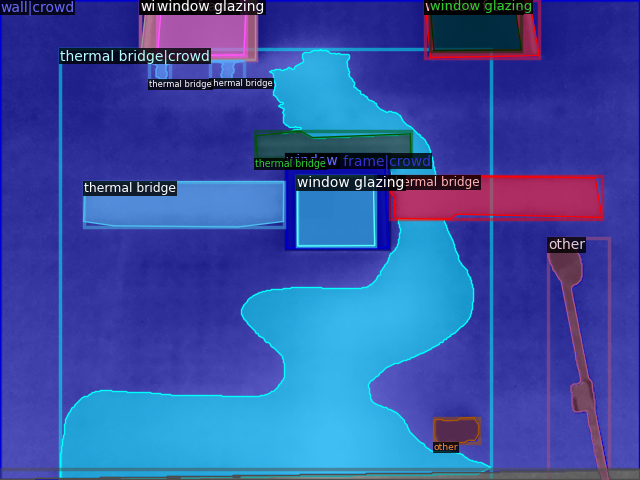

In [ ]:
#inference on experiment dataset
dataset_dicts = DatasetCatalog.get("experiment_all")

for d in random.sample(dataset_dicts, 5):
    print (d["file_name"])
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)

    v = Visualizer(img[:, :, ::-1],
                  metadata=my_dataset_train_metadata,
                  scale=1
                  )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])
    visualizer = Visualizer(img[:, :, ::-1],
                            metadata=my_dataset_train_metadata,
                            scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Saved Models

## Saved model 4000 iterations

### Load model checkpoint

In [ ]:
modelversion_load = '20240314_transforms_4000'
modelname_load = "instancethermal_"+modelversion_load+'.pth'
modelckptpath = os.path.join("/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/output", modelname_load)

In [ ]:
#load checkpoint
DetectionCheckpointer(trainer.model).load(modelckptpath)

[03/15 11:53:54 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/output/instancethermal_20240314_transforms_4000.pth ...


{}

### Evaluate loaded model

In [ ]:
# Evaluate model on validation dataset

evaluator = COCOEvaluator("coco_dataset_val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "coco_dataset_val")
inference_on_dataset(trainer.model, val_loader, evaluator)

[03/15 11:36:06 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [03/15 11:36:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[03/15 11:36:06 d2.data.datasets.coco]: Loaded 6 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/output.json
[03/15 11:36:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[03/15 11:36:06 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[03/15 11:36:06 d2.data.common]: Serializing 6 elements to byte tensors and concatenating them all ...
[03/15 11:36:06 d2.data.common]: Serialized dataset takes 0.12 MiB
[03/15 11:36:06 d2.evaluation

OrderedDict([('bbox',
              {'AP': 22.53942477232782,
               'AP50': 31.667182626229074,
               'AP75': 24.267815582333657,
               'APs': 15.014589093933667,
               'APm': 15.648684201926919,
               'APl': 31.06096390176688,
               'AP-wall': 8.24045261669024,
               'AP-window glazing': 40.03380788801017,
               'AP-door': 0.0,
               'AP-window': 55.75934191034949,
               'AP-window frame': 0.0,
               'AP-thermal bridge': 11.482800380878423,
               'AP-door frame': 0.0,
               'AP-floor': 90.0,
               'AP-door door': 0.0,
               'AP-other': 19.877844927349877}),
             ('segm',
              {'AP': 22.61913696931383,
               'AP50': 31.17970909768498,
               'AP75': 25.360106803910217,
               'APs': 14.207234406753747,
               'APm': 14.441289678282002,
               'APl': 32.69149332696428,
               'AP-wall': 7.

In [ ]:
# Evaluate model on test dataset

evaluator = COCOEvaluator("coco_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "coco_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

[03/15 11:36:28 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [03/15 11:36:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[03/15 11:36:28 d2.data.datasets.coco]: Loaded 4 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test/output.json
[03/15 11:36:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[03/15 11:36:28 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[03/15 11:36:28 d2.data.common]: Serializing 4 elements to byte tensors and concatenating them all ...
[03/15 11:36:28 d2.data.common]: Serialized dataset takes 0.07 MiB
[03/15 11:36:28 d2.evaluation.eva

OrderedDict([('bbox',
              {'AP': 32.069493023338765,
               'AP50': 41.50897703524245,
               'AP75': 36.974920734948384,
               'APs': 44.6300550546328,
               'APm': 32.3294518414624,
               'APl': 36.063185805760064,
               'AP-wall': 30.442244224422442,
               'AP-window glazing': 54.03933253076026,
               'AP-door': 0.0,
               'AP-window': 73.9535703570357,
               'AP-window frame': 0.0,
               'AP-thermal bridge': 13.728429985855728,
               'AP-door frame': 0.0,
               'AP-floor': 99.99999999999997,
               'AP-door door': 0.0,
               'AP-other': 48.53135313531352}),
             ('segm',
              {'AP': 28.85516510732018,
               'AP50': 39.868241533120816,
               'AP75': 33.66576379238491,
               'APs': 45.544565170802784,
               'APm': 29.982070344609774,
               'APl': 31.392411860233643,
               'A

### Set up predictor

In [ ]:
#using validation labels instead of the training labels
cfg.DATASETS.TEST = ("coco_dataset_val", )
my_dataset_val_metadata = MetadataCatalog.get(cfg.DATASETS.TEST[0])


In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything previously set. Changed for inference:
cfg.MODEL.WEIGHTS = modelckptpath  # path to the current model
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.75   # set custom testing threshold
predictor = DefaultPredictor(cfg)

[03/15 11:54:17 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/output/instancethermal_20240314_transforms_4000.pth ...


#### Validation dataset

[03/15 11:55:38 d2.data.datasets.coco]: Loaded 6 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/output.json
/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/IR_397.jpg


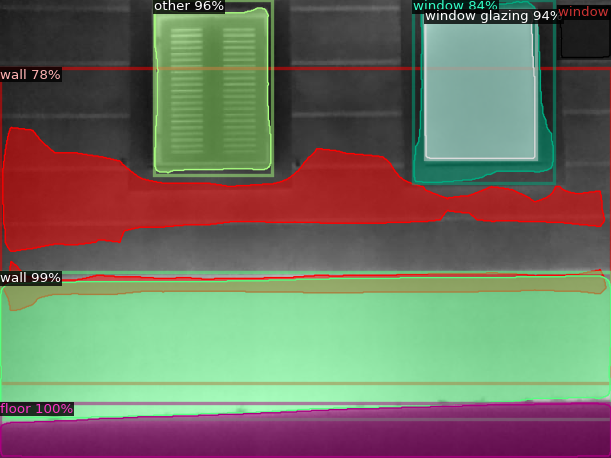

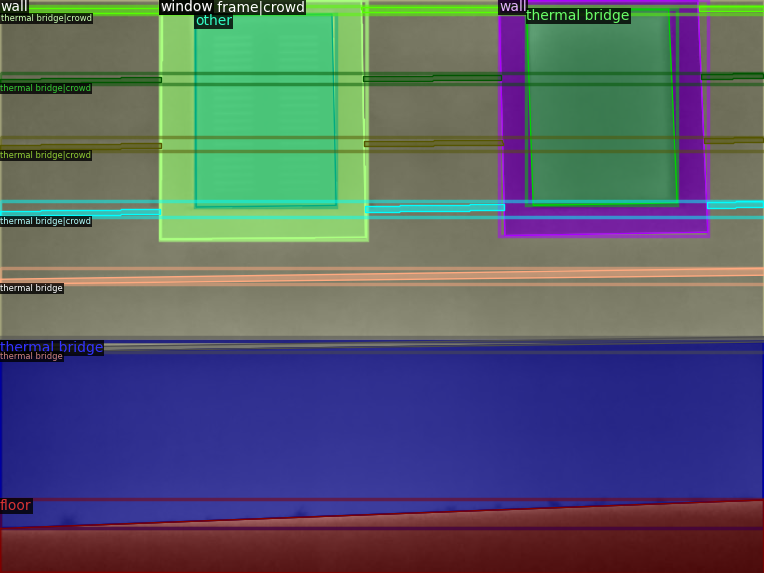

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/IR_550.jpg


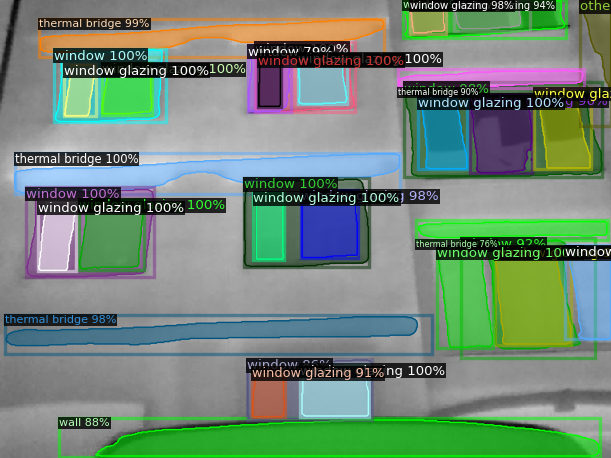

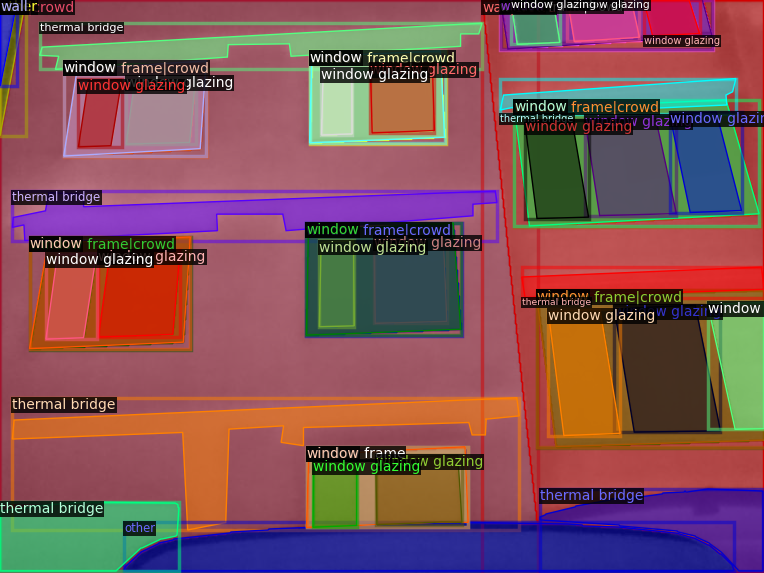

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/IR_540.jpg


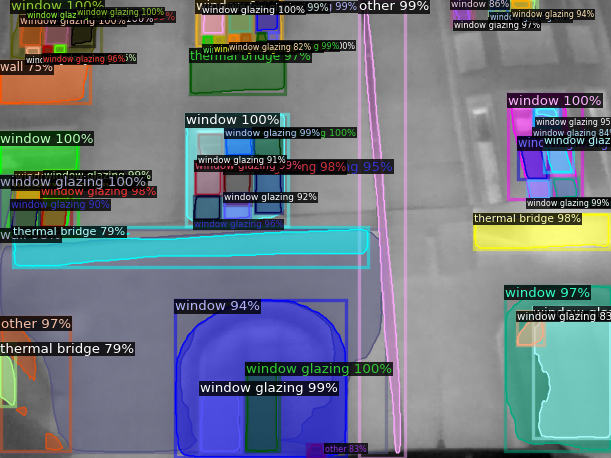

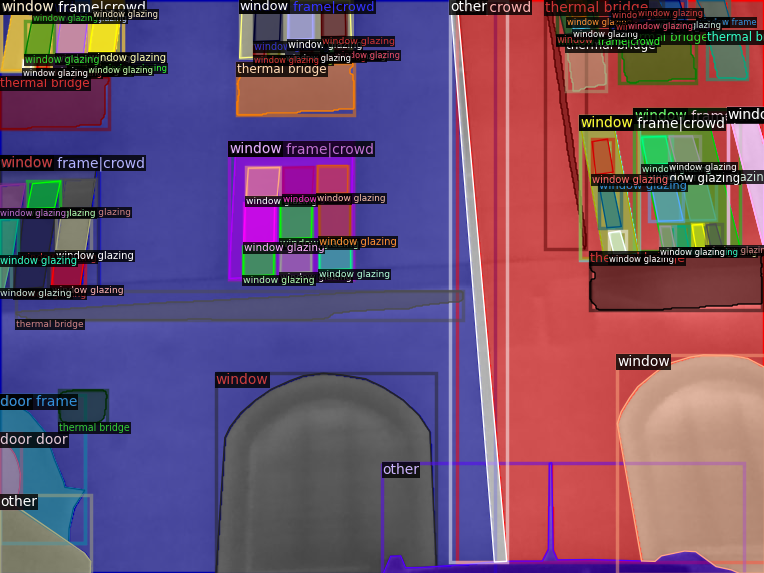

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/IR_561.jpg


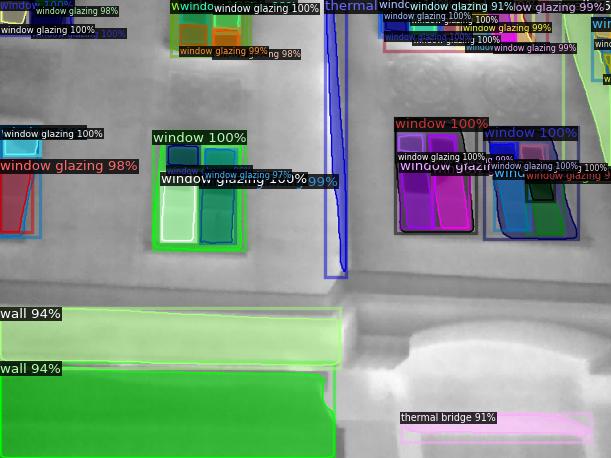

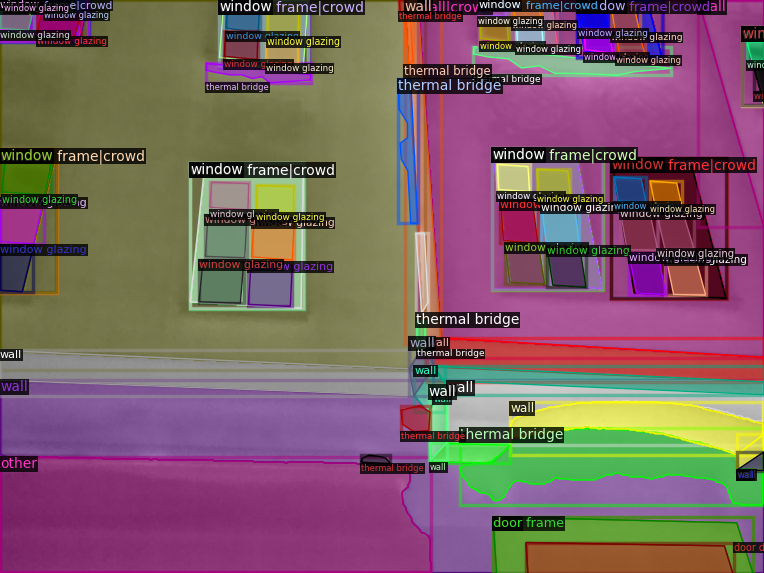

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/IR_396.jpg


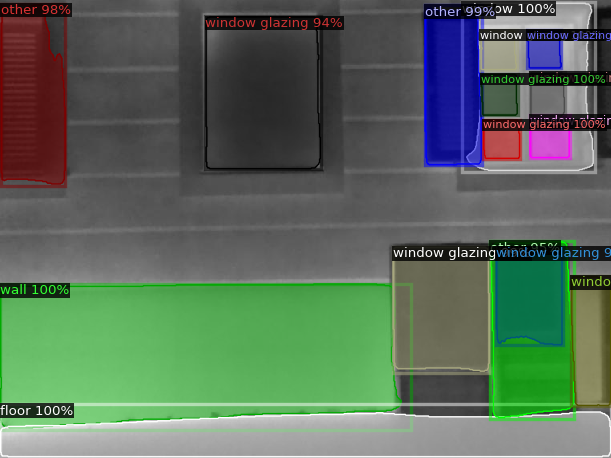

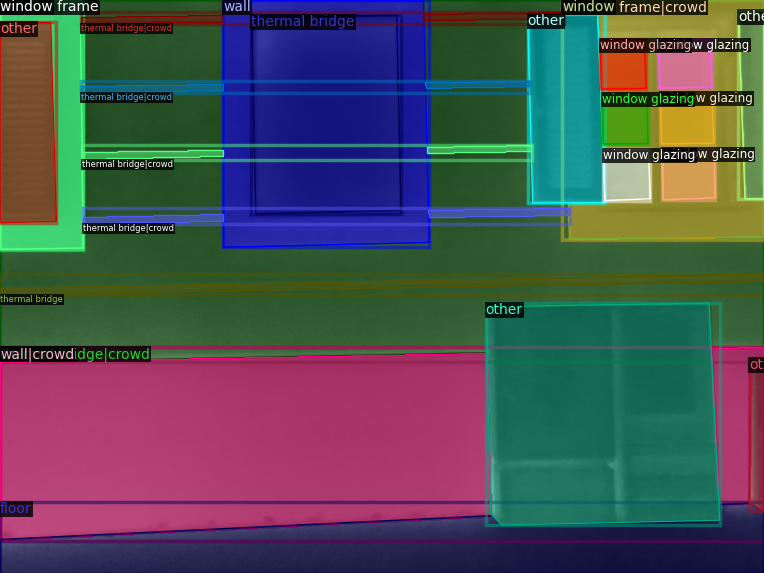

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/IR_395.jpg


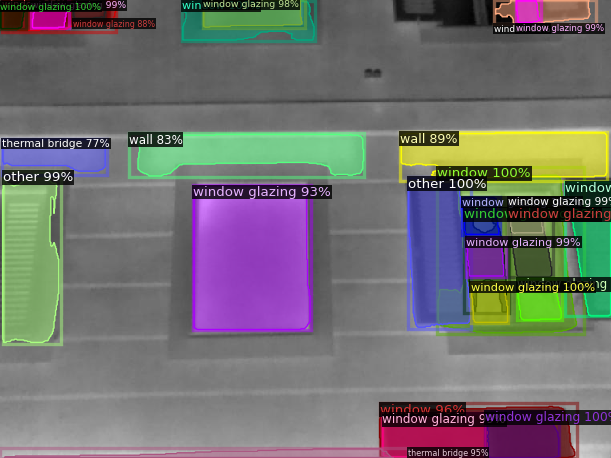

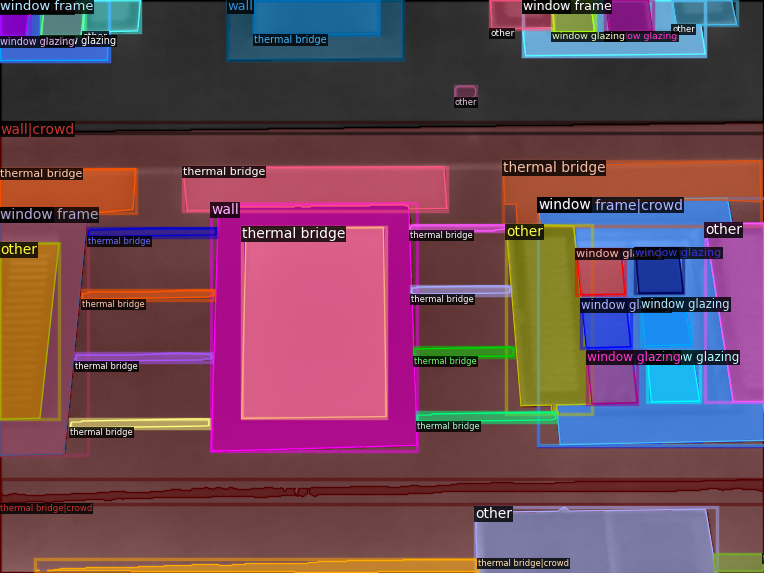

In [ ]:
#inference on validation data
my_dataset_train_metadata = MetadataCatalog.get("coco_dataset_train")

dataset_dicts = DatasetCatalog.get("coco_dataset_val")

for d in random.sample(dataset_dicts, 2):
    print (d["file_name"])
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)

    v = Visualizer(img[:, :, ::-1],
                  metadata=my_dataset_train_metadata,
                  scale=0.8
                  )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])
    visualizer = Visualizer(img[:, :, ::-1],
                            metadata=my_dataset_train_metadata,
                            scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

#### Test dataset

[03/15 11:54:46 d2.data.datasets.coco]: Loaded 4 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test/output.json
/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test/IR_37.jpg


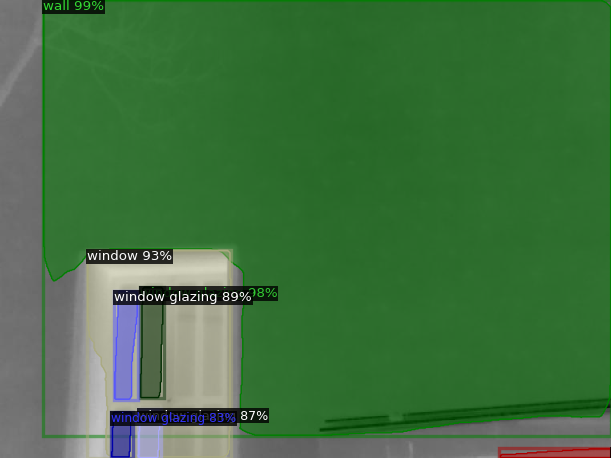

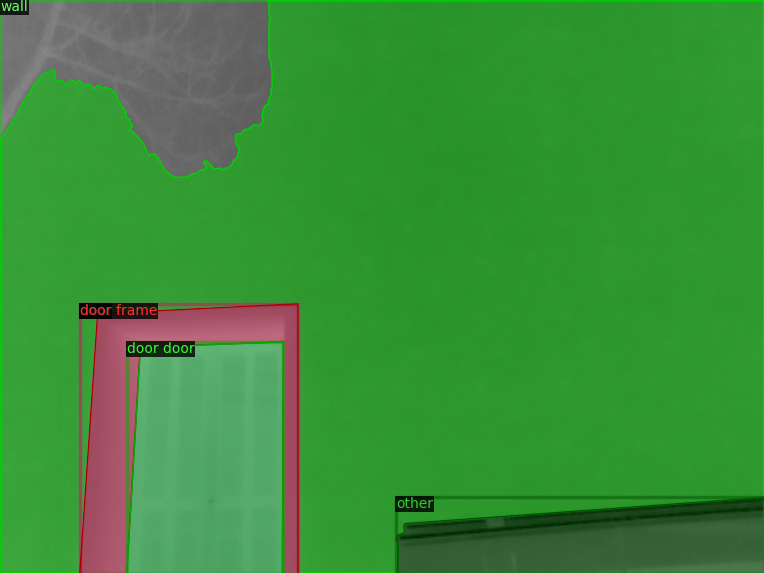

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test/IR_551.jpg


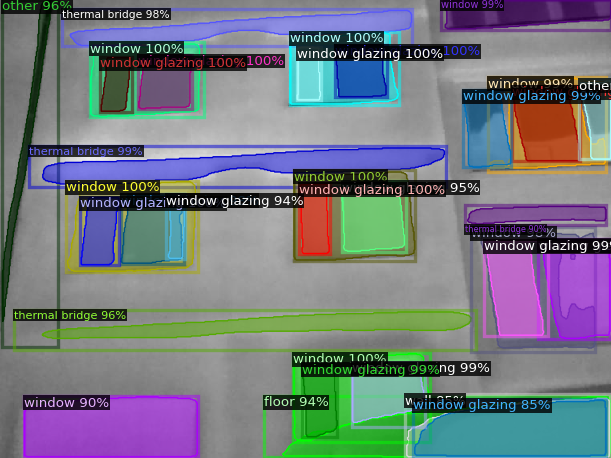

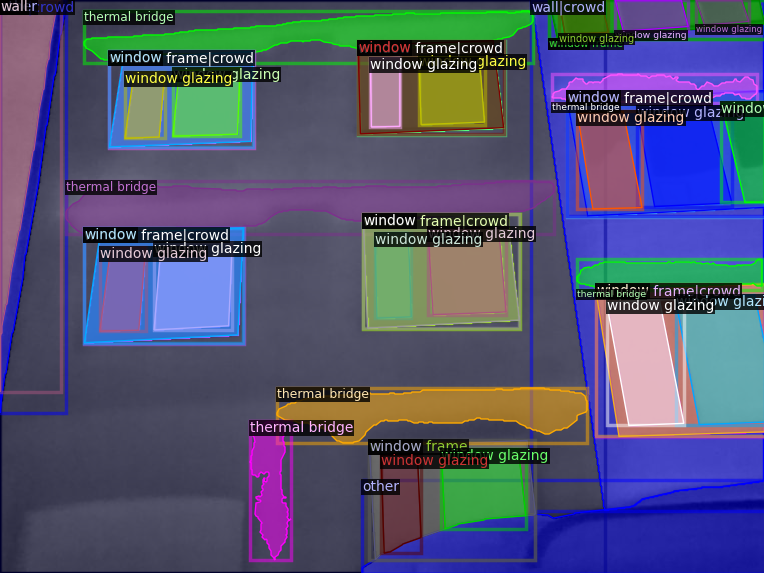

In [ ]:
#inference on test data
my_dataset_train_metadata = MetadataCatalog.get("coco_dataset_train")

dataset_dicts = DatasetCatalog.get("coco_dataset_test")

for d in random.sample(dataset_dicts, 2):
    print (d["file_name"])
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)

    v = Visualizer(img[:, :, ::-1],
                  metadata=my_dataset_train_metadata,
                  scale=0.8
                  )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])
    visualizer = Visualizer(img[:, :, ::-1],
                            metadata=my_dataset_train_metadata,
                            scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

## Saved model 5000 iterations all

### Load model checkpoint

In [ ]:
modelversion_load = '20240314_transforms_5000_all'
modelname_load = "instancethermal_"+modelversion_load+'.pth'
modelckptpath = os.path.join("/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/output", modelname_load)

In [ ]:
#load checkpoint
DetectionCheckpointer(trainer.model).load(modelckptpath)

[03/15 11:57:08 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/output/instancethermal_20240314_transforms_5000_all.pth ...


{}

### Evaluate loaded model

In [ ]:
# Evaluate model on validation dataset

evaluator = COCOEvaluator("coco_dataset_val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "coco_dataset_val")
inference_on_dataset(trainer.model, val_loader, evaluator)

[03/15 11:57:14 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [03/15 11:57:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[03/15 11:57:14 d2.data.datasets.coco]: Loaded 6 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/output.json
[03/15 11:57:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[03/15 11:57:14 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[03/15 11:57:14 d2.data.common]: Serializing 6 elements to byte tensors and concatenating them all ...
[03/15 11:57:14 d2.data.common]: Serialized dataset takes 0.12 MiB
[03/15 11:57:14 d2.evaluation

OrderedDict([('bbox',
              {'AP': 38.9655041144192,
               'AP50': 47.23566218261278,
               'AP75': 43.72017630371716,
               'APs': 31.721065812235082,
               'APm': 33.99620369046306,
               'APl': 57.80088013500598,
               'AP-wall': 41.213282591995466,
               'AP-window glazing': 61.688888335658554,
               'AP-door': 0.0,
               'AP-window': 69.52039249891834,
               'AP-window frame': 0.0,
               'AP-thermal bridge': 37.36508341516415,
               'AP-door frame': 0.0,
               'AP-floor': 100.0,
               'AP-door door': 0.0,
               'AP-other': 79.86739430245545}),
             ('segm',
              {'AP': 36.76450728292992,
               'AP50': 47.083368304156615,
               'AP75': 43.315050070797604,
               'APs': 32.3697582360146,
               'APm': 31.26111063363586,
               'APl': 56.708588199045465,
               'AP-wall': 38.10

In [ ]:
# Evaluate model on test dataset

evaluator = COCOEvaluator("coco_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "coco_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

[03/15 11:43:40 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [03/15 11:43:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[03/15 11:43:40 d2.data.datasets.coco]: Loaded 4 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test/output.json
[03/15 11:43:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[03/15 11:43:40 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[03/15 11:43:40 d2.data.common]: Serializing 4 elements to byte tensors and concatenating them all ...
[03/15 11:43:40 d2.data.common]: Serialized dataset takes 0.07 MiB
[03/15 11:43:40 d2.evaluation.eva

OrderedDict([('bbox',
              {'AP': 62.75750807210761,
               'AP50': 74.81046676096182,
               'AP75': 70.94502454447125,
               'APs': 63.691244124412435,
               'APm': 65.40172665035986,
               'APl': 70.99744760800867,
               'AP-wall': 73.22277227722773,
               'AP-window glazing': 75.5200752205261,
               'AP-door': 89.99999999999999,
               'AP-window': 86.89906490649065,
               'AP-window frame': 0.0,
               'AP-thermal bridge': 40.59653465346535,
               'AP-door frame': 0.0,
               'AP-floor': 99.99999999999997,
               'AP-door door': 89.99999999999999,
               'AP-other': 71.33663366336633}),
             ('segm',
              {'AP': 60.07543351313153,
               'AP50': 73.4991356278485,
               'AP75': 68.07841288330513,
               'APs': 69.55931467958258,
               'APm': 50.518740353789795,
               'APl': 68.30185839096

### Set up predictor

In [ ]:
#using validation labels instead of the training labels
cfg.DATASETS.TEST = ("coco_dataset_val", )
my_dataset_val_metadata = MetadataCatalog.get(cfg.DATASETS.TEST[0])


In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything previously set. Changed for inference:
cfg.MODEL.WEIGHTS = modelckptpath  # path to the current model
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.75   # set custom testing threshold
predictor = DefaultPredictor(cfg)

[03/15 11:44:17 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/output/instancethermal_20240314_transforms_5000_all.pth ...


#### Validation dataset

[03/15 11:46:02 d2.data.datasets.coco]: Loaded 6 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/output.json
/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/IR_397.jpg


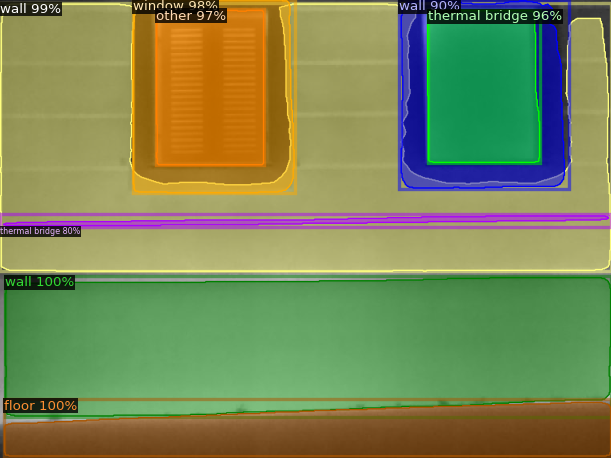

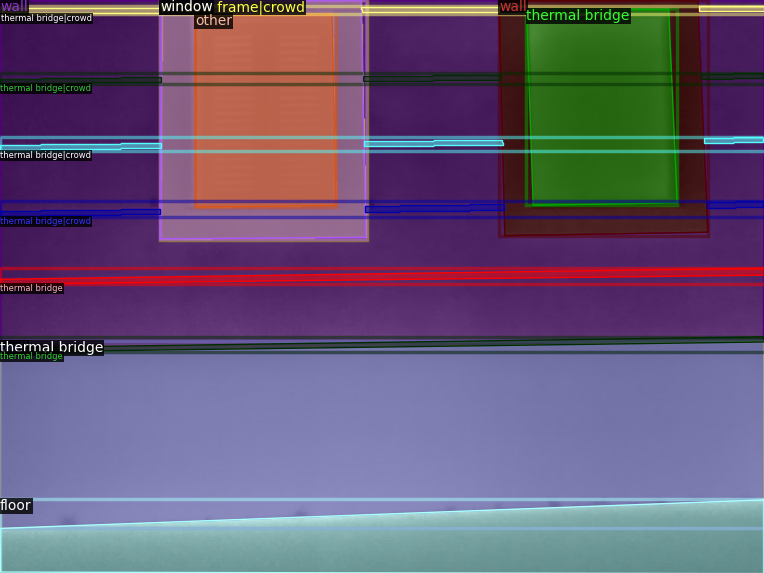

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/IR_540.jpg


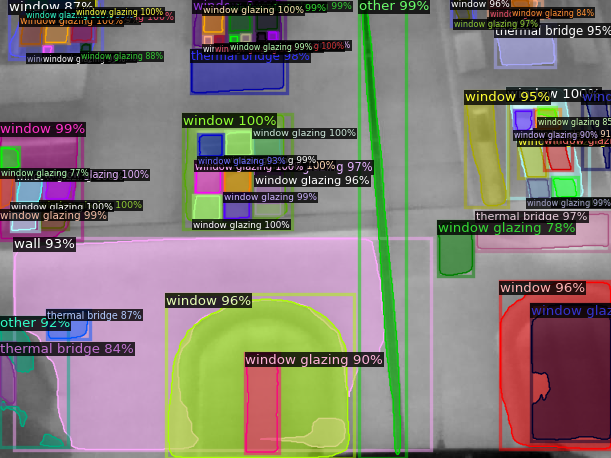

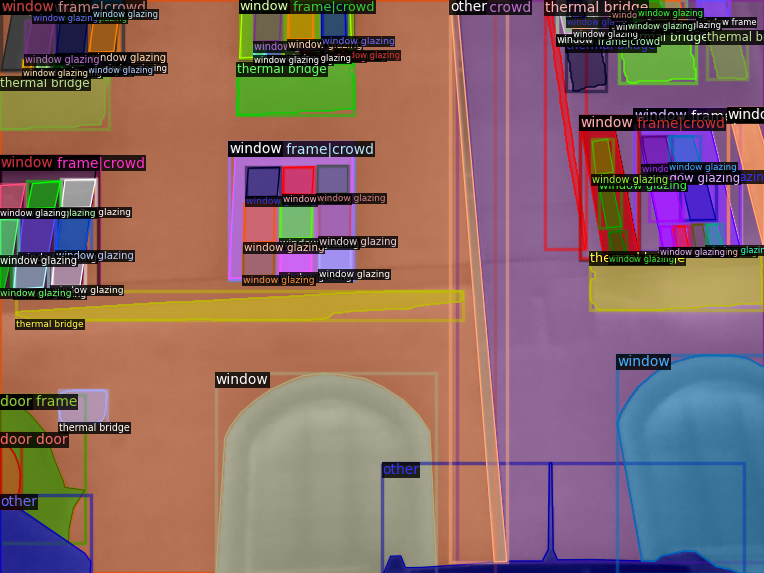

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/IR_395.jpg


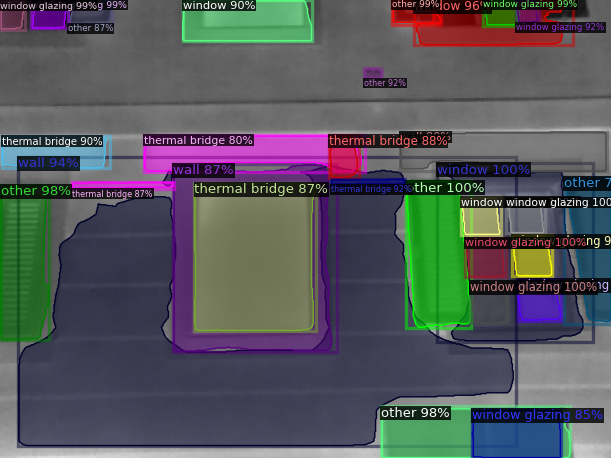

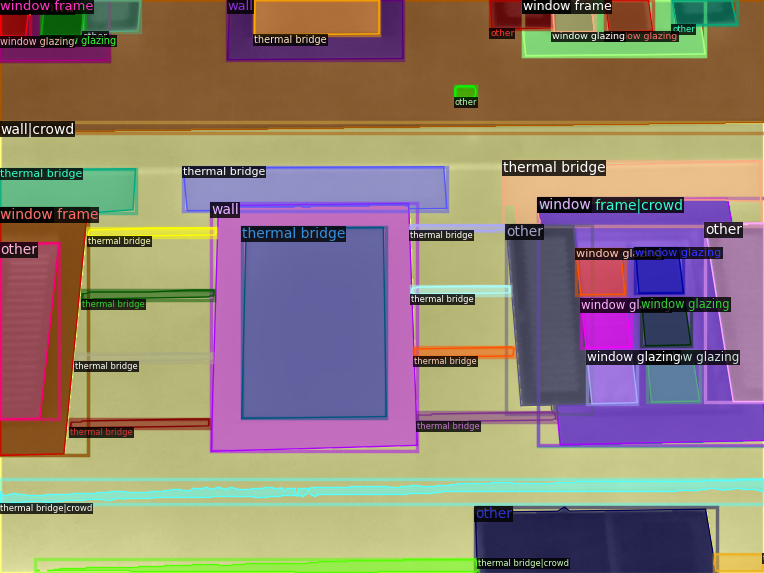

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/IR_396.jpg


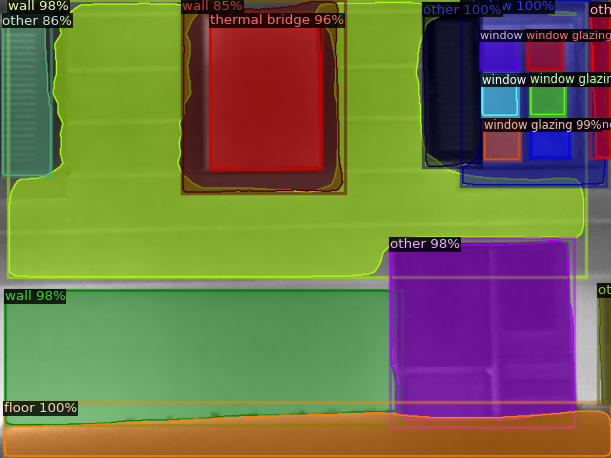

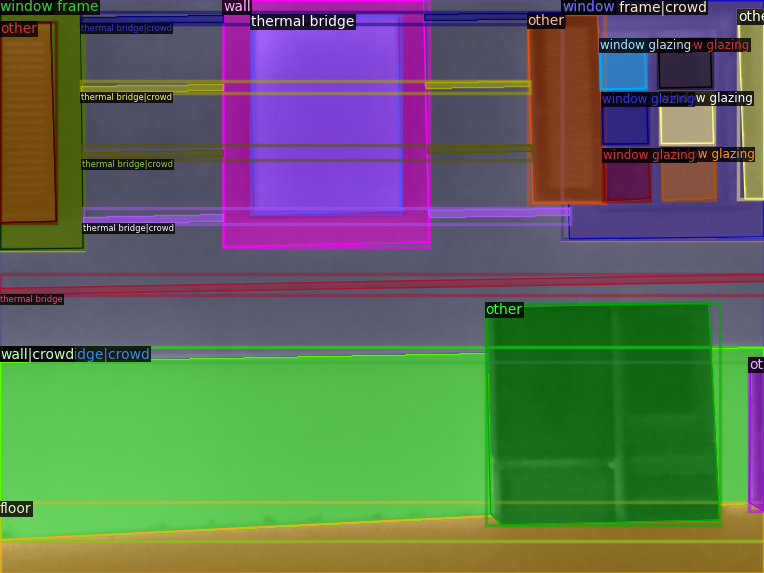

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/IR_561.jpg


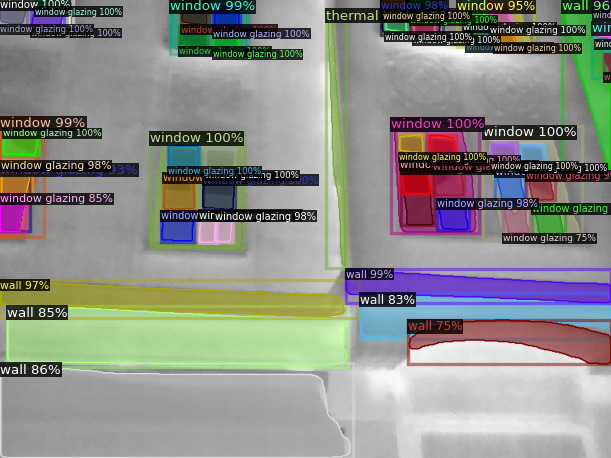

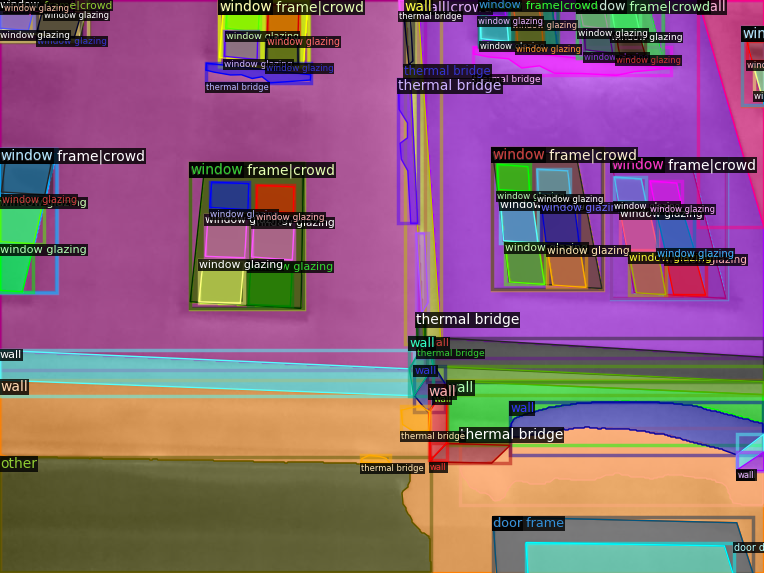

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Validate/IR_550.jpg


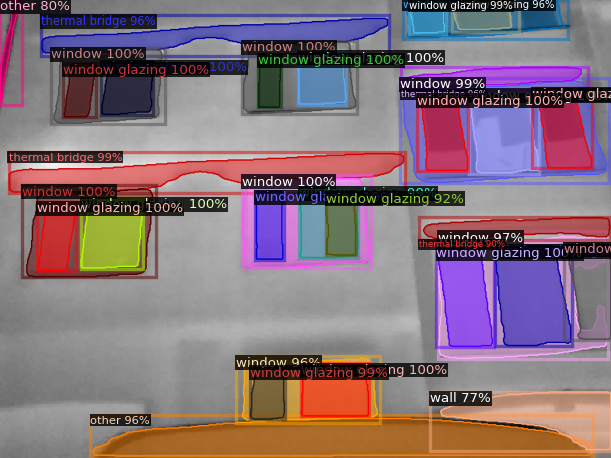

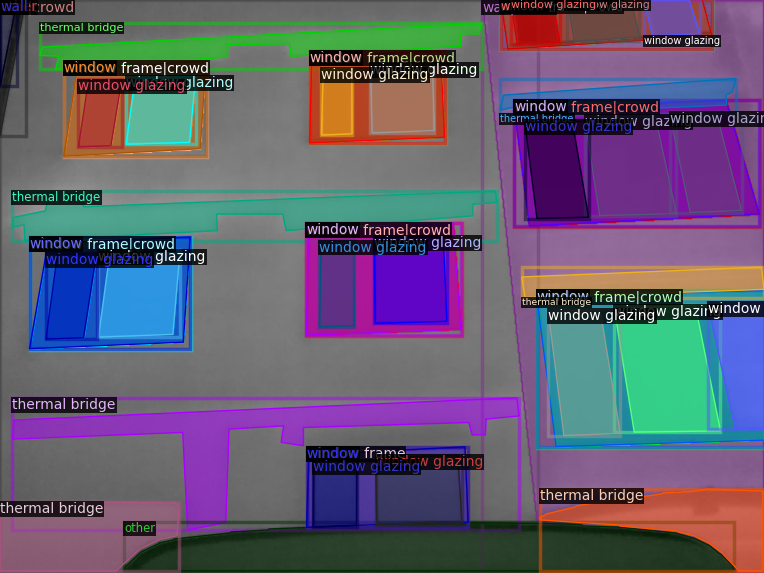

In [ ]:
#inference on validation data
my_dataset_train_metadata = MetadataCatalog.get("coco_dataset_train")

dataset_dicts = DatasetCatalog.get("coco_dataset_val")

for d in random.sample(dataset_dicts, 2):
    print (d["file_name"])
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)

    v = Visualizer(img[:, :, ::-1],
                  metadata=my_dataset_train_metadata,
                  scale=0.8
                  )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])
    visualizer = Visualizer(img[:, :, ::-1],
                            metadata=my_dataset_train_metadata,
                            scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

#### Test dataset

[03/15 11:30:19 d2.data.datasets.coco]: Loaded 4 images in COCO format from /content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test/output.json
/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test/IR_37.jpg


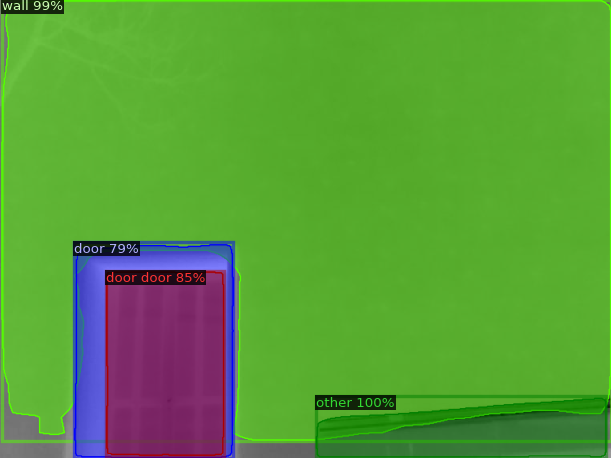

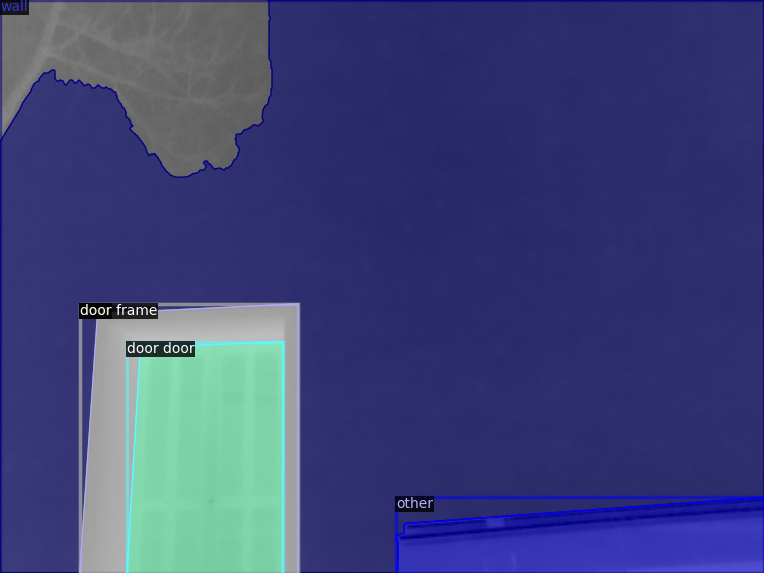

/content/drive/MyDrive/TUM/Thesis/Thermal/ModelTraining/input/thermal23/darwin_files/content/thermal23/cms/thermal23/images/Test/IR_571.jpg


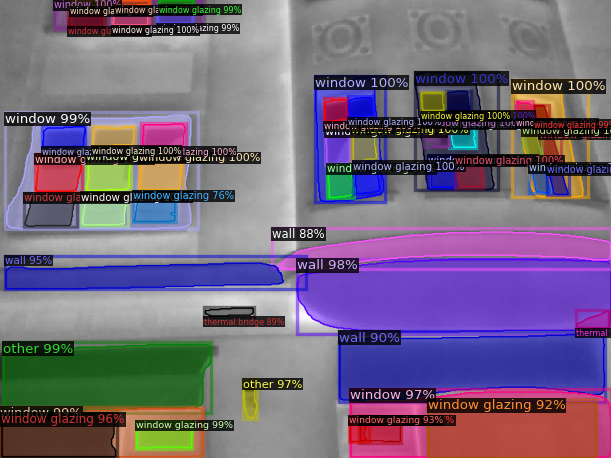

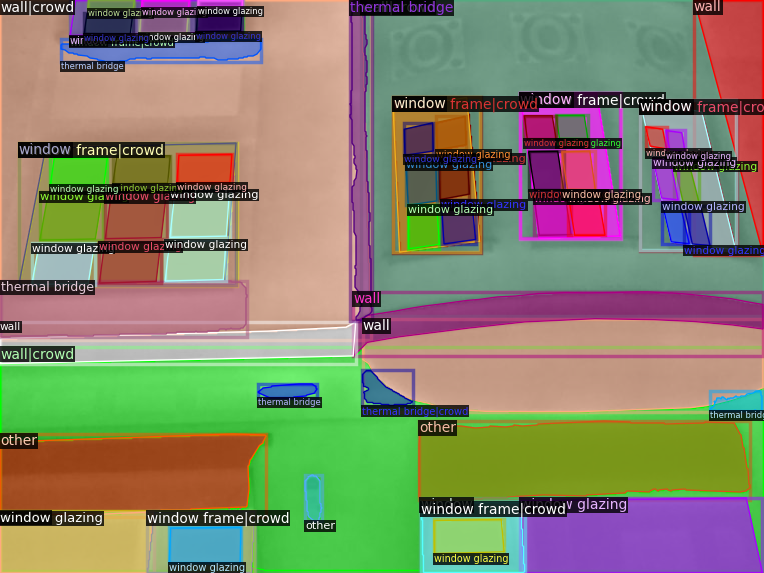

In [ ]:
#inference on validation data
my_dataset_train_metadata = MetadataCatalog.get("coco_dataset_train")

dataset_dicts = DatasetCatalog.get("coco_dataset_test")

for d in random.sample(dataset_dicts, 2):
    print (d["file_name"])
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)

    v = Visualizer(img[:, :, ::-1],
                  metadata=my_dataset_train_metadata,
                  scale=0.8
                  )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])
    visualizer = Visualizer(img[:, :, ::-1],
                            metadata=my_dataset_train_metadata,
                            scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Push to Hugging Face

In [ ]:
from huggingface_hub import notebook_login

notebook_login()

In [ ]:
from huggingface_hub import HfApi

api = HfApi()
api.upload_file(
    path_or_fileobj=modelckptpath,
    path_in_repo="model.pth",
    repo_id="gerdac/instancethermal"
)
# Repeat for config.json if applicable


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


instancethermal_20240314_transforms_5000_all.pth:   0%|          | 0.00/176M [00:00<?, ?B/s]

CommitInfo(commit_url='https://huggingface.co/gerdac/instancethermal/commit/bd9fabfc628983b2be728bf00909c123ebe658b1', commit_message='Upload model.pth with huggingface_hub', commit_description='', oid='bd9fabfc628983b2be728bf00909c123ebe658b1', pr_url=None, pr_revision=None, pr_num=None)